# Question 1: Vanilla VAE

## Butterfly Dataset

In [ ]:
import torch
import torch.nn as nn
from torchvision.datasets import MNIST
from torchvision.transforms import transforms
import numpy as np

#import F
from torch.nn import functional as F

In [ ]:
# Set device to cuda 
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('Device:', device)

In [ ]:
import torchvision.transforms as transforms

image_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    
    # Data augmentation techniques
    transforms.RandomHorizontalFlip(),           # Randomly flip images horizontally
    transforms.RandomRotation(10),               # Randomly rotate images by ±10 degrees
   # Randomly flip images vertically

    # Conversion and normalization
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5]),         # Normalization
    transforms.Lambda(lambda x: x.to(device))   # Move tensor to the specified device
])


In [ ]:
from torchvision import datasets

trainFolder = 'ImagesD'
trainDataset = datasets.ImageFolder(trainFolder, transform=image_transform)
print('Train dataset:', len(trainDataset))

In [ ]:
#Import DataLoader
from torch.utils.data import DataLoader
batchSize = 64
trainLoader = DataLoader(trainDataset, batch_size=batchSize, shuffle=True)

In [ ]:
# print some images from the trainLoader
import matplotlib.pyplot as plt
import numpy as np
for images, labels in trainLoader:
    fig, axes = plt.subplots(figsize=(10,4), ncols=4)
    for i in range(4):
        ax = axes[i]
        ax.imshow(images[i].cpu().numpy().transpose(1,2,0).squeeze())
    break

In [ ]:
class VariationalAutoEncoder(nn.Module):
    
    def __init__(self):
        super(VariationalAutoEncoder, self).__init__()
        
        # Make encoder to accept 128x128 images across 3 channels
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=8, kernel_size=3, stride=2, padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride=2, padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=2, padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=2, padding=1), # 8x8
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.Flatten(),
            nn.Linear(64*8*8, 64*4*4),
            nn.ReLU(),
            nn.Linear(64*4*4, 256),
            
        )
        
        # mean and log variance
        self.mean = nn.Linear(256, 128)
        self.logvar = nn.Linear(256, 128)
        
        # decoder
        self.decoder = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, 64*8*8),
            nn.ReLU(),
            nn.Unflatten(1, (64, 8, 8)),
            
            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=32, out_channels=16, kernel_size=3, stride=2, padding=1, output_padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=16, out_channels=8, kernel_size=3, stride=2, padding=1, output_padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, padding=1, output_padding=1), # 128x128
            nn.Tanh()
        )
        
    def reparameterize(self, mean, logvar):
        std = torch.exp(0.5*logvar)
        eps = torch.randn_like(std)
        return mean + eps*std
    
    def forward(self, x):
        x = self.encoder(x)
        mean = self.mean(x)
        logvar = self.logvar(x)
        z = self.reparameterize(mean, logvar)
        x = self.decoder(z)
        return x, mean, logvar

In [ ]:
from torchsummary import summary
model = VariationalAutoEncoder().to(device)
summary(model, (3, 128, 128))

In [ ]:
def lossFunction(reconX, X, mean, logVariance):
    mseLoss = F.mse_loss(reconX, X, reduction='sum')
    KLdivergenceLoss = torch.mean(-0.5 * torch.sum(1 + logVariance - mean.pow(2) - logVariance.exp(), dim = 1), dim = 0)
    return [0.001*mseLoss + 1*KLdivergenceLoss, 0.001*mseLoss, 1*KLdivergenceLoss]

    # Multiplied by 0.001 and 1 to bring losses to same scale as discussed in Teams Chat

In [ ]:
# Initialize optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [ ]:
import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torchvision.utils import make_grid, save_image
from tqdm import tqdm  # Import tqdm
import matplotlib.pyplot as plt

numEpochs = 100

# Initialize lists to store training losses
trainLosses = []
trainMSELosses = []
trainKLDivergences = []

for epoch in range(numEpochs):
    # Training Phase
    model.train()
    trainL = 0
    trainMSEL = 0
    trainKLD = 0
    
    # Use tqdm to create a progress bar for training
    with tqdm(total=len(trainLoader), desc=f"Epoch {epoch + 1}/{numEpochs}", unit="batch") as pbar:
        for batchIndex, (imageSet, labelSet) in enumerate(trainLoader):
            imageSet = imageSet.to(device)
            
            optimizer.zero_grad()
            reconImageSet, mean, logvar = model(imageSet)
            loss, mseLoss, KLdivergenceLoss = lossFunction(reconImageSet, imageSet, mean, logvar)
            
            # Backpropagation on MSE + KL divergence loss
            loss.backward()
            optimizer.step()
            
            # Update training losses
            trainL += loss.item()
            trainMSEL += mseLoss.item()
            trainKLD += KLdivergenceLoss.item()
            
            # Update progress bar
            pbar.set_postfix({'loss': loss.item(), 'MSE': mseLoss.item(), 'KL': KLdivergenceLoss.item()})
            pbar.update(1)
    
    trainLosses.append(trainL / len(trainLoader))
    trainMSELosses.append(trainMSEL / len(trainLoader))
    trainKLDivergences.append(trainKLD / len(trainLoader))

    # Display average training loss for the epoch
    print(f"Epoch {epoch + 1}: Train Loss: {trainL / len(trainLoader):.4f}")

    # Save the reconstructed images every epoch
    with torch.no_grad():
        imageSet = next(iter(trainLoader))[0].to(device)
        reconImageSet, _, _ = model(imageSet)
        
        # Save original and reconstructed images
        original_grid = make_grid(imageSet, nrow=8, normalize=True)
        recon_grid = make_grid(reconImageSet, nrow=8, normalize=True)
        
        save_image(original_grid, f'original_images_epoch.png')
        save_image(recon_grid, f'reconstructed_images_epoch.png')

    # Generate new images
    with torch.no_grad():
        z = torch.randn(64, 128).to(device)
        newImageSet = model.decoder(z)
        newImageSet = make_grid(newImageSet, nrow=8, normalize=True)
        
        save_image(newImageSet, f'generated_images_epoch.png')



In [ ]:
import matplotlib.pyplot as plt

# Modify the function to accept start and end epoch indices
def plot_loss_curves(train_losses, train_mse_losses, train_kl_divergences, start_epoch=1, end_epoch=None):
    if end_epoch is None or end_epoch > len(train_losses):
        end_epoch = len(train_losses)

    # Calculate the range for the specified epochs
    epochs = range(start_epoch, end_epoch + 1)
    sliced_train_losses = train_losses[start_epoch - 1:end_epoch]
    sliced_train_mse_losses = train_mse_losses[start_epoch - 1:end_epoch]
    sliced_train_kl_divergences = train_kl_divergences[start_epoch - 1:end_epoch]

    # Plot total loss
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, sliced_train_losses, label='Training Loss', color='blue')
    plt.title('Total Training Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

    # Plot MSE and KL divergence losses
    plt.figure(figsize=(10, 5))
    plt.plot(epochs, sliced_train_mse_losses, label='Training MSE Loss', color='green')
    plt.plot(epochs, sliced_train_kl_divergences, label='Training KL Divergence Loss', color='purple')
    plt.title('MSE and KL Divergence Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()

    plt.show()

# Example call with specific epoch range (e.g., epochs 10 to 50)
plot_loss_curves(trainLosses, trainMSELosses, trainKLDivergences, start_epoch=1, end_epoch=100)


In this case we did not multiply the KL divergence term by beta or we can say in this case beta is 1. We multiplied the Reconstruction MSE Loss by 0.001 to bring losses to lower scales as it was of order of 10^5.

#### Here are original vs reconstructured images

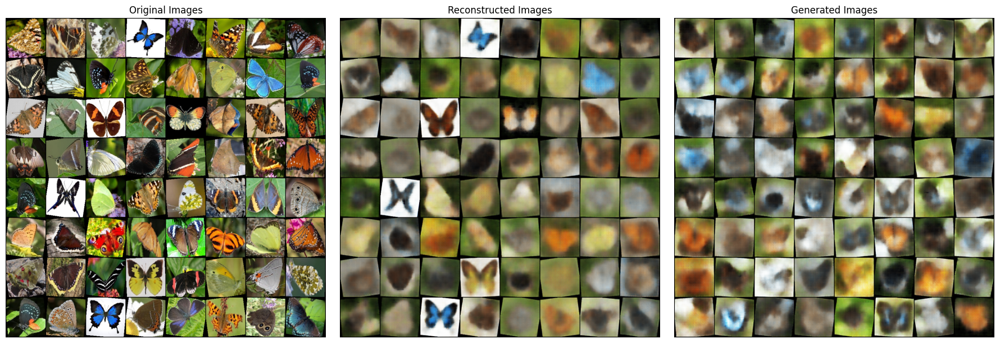

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('original_images_epoch.png', 'reconstructed_images_epoch.png', 'generated_images_epoch.png')


Here are the loss curves for the model

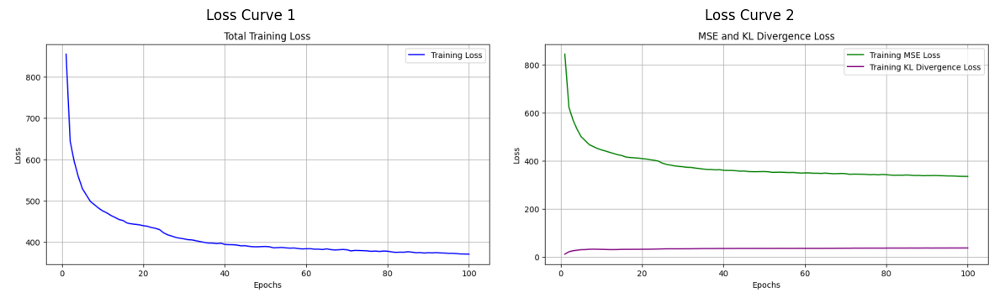

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/loss1.png', 'ImagesF/loss2.png')


Here is another model which we trained for 100 epochs with Beta = 1 and Reconstruction Loss Multiplier = 0.1 instead of 0.001

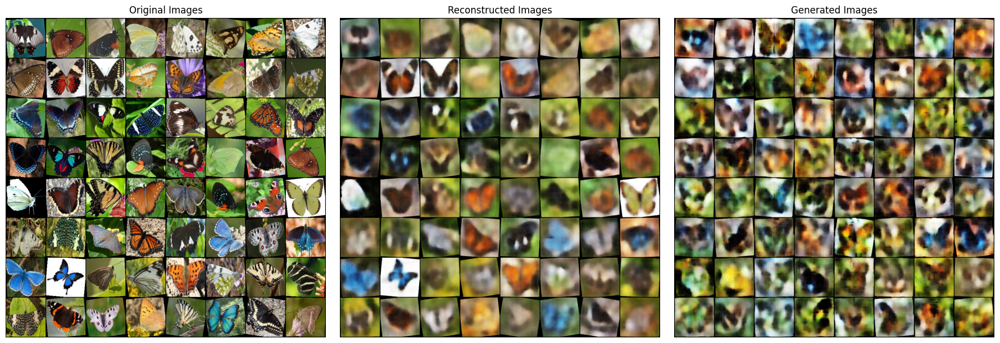

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('original_images_epoch.png', 'reconstructed_images_epoch.png', 'generated_images_epoch.png')


We can observe that by above change, reconstruction is little better than previous model but generation is not that good.
Here are the loss curves for the model

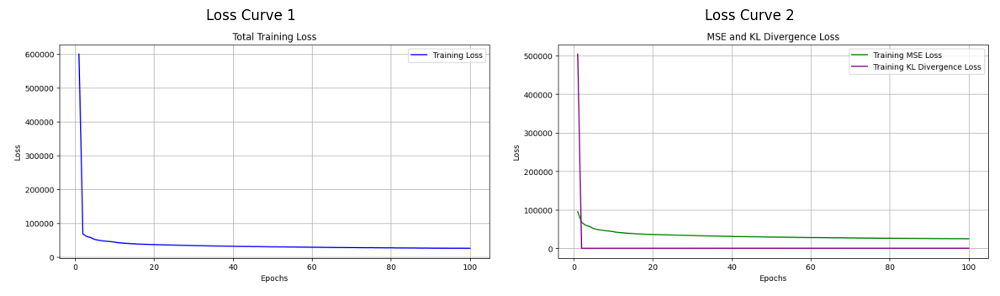

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/loss3.png', 'ImagesF/loss4.png')


Next we sampled 5 latent vectors (z) from N(mu,sigma) where mu,sigma were output of encoder and we feeded mean of these 5 latent vectors to decoder, and we trained model in this fashion to get the following results.

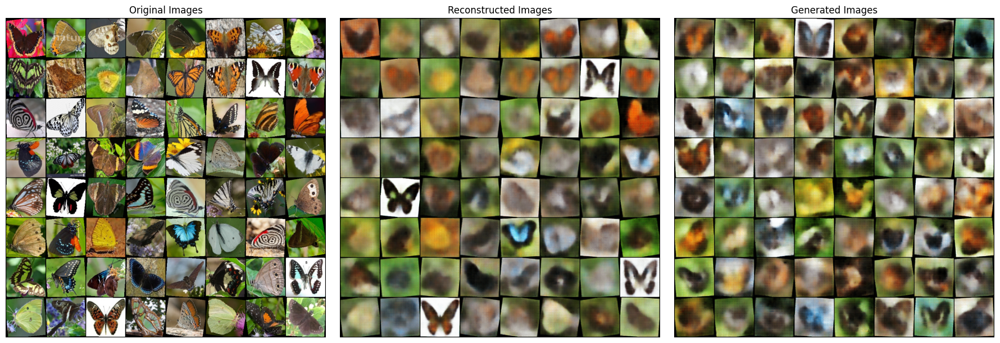

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/Ques1Latent5Original.png', 'ImagesF/Ques1Latent5Reconstruct.png', 'ImagesF/Ques1Latent5Generate.png')


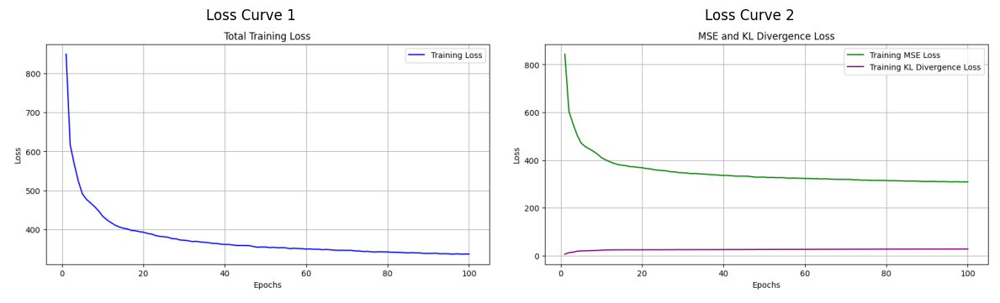

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/Ques1Latent5Loss1.png', 'ImagesF/Ques1Latent5Loss2.png')


This time we feeded mean of 10 latent vectors to decoder and trained model for 100 epochs. Here are the results

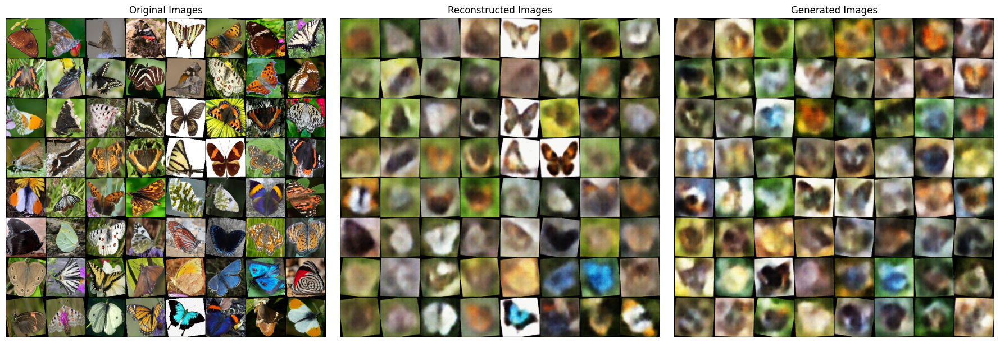

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/Ques1Latent10Original.png', 'ImagesF/Ques1Latent10Reconstruct.png', 'ImagesF/Ques1Latent10Generate.png')


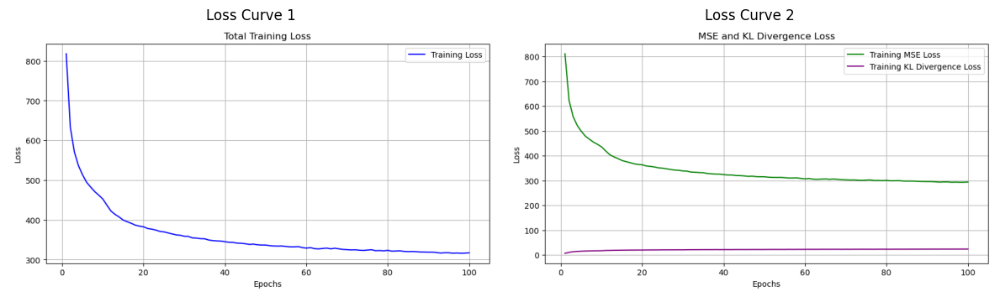

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/Ques1Latent10Loss1.png', 'ImagesF/Ques1Latent10Loss2.png')


**Observations**
We can see that in the case when we feeded mean of 5 latent vectors to the decoder while training, outputs were slightly better than the case when we feeded mean of 10 as well as when we feeded only 1 latent vector to the decoder

### Computing FID
We computed FID using Pytorch FID library and also from scratch using the below code

In [ ]:
import os
import torch
import numpy as np
from torchvision import transforms, models
from torch.utils.data import DataLoader, Dataset
from scipy.linalg import sqrtm
from PIL import Image
import torch.nn as nn

class CustomImageDataset(Dataset):
    def __init__(self, folder_path, transform=None):
        self.folder_path = folder_path
        self.transform = transform
        self.image_files = [
            os.path.join(folder_path, file)
            for file in os.listdir(folder_path)
            if file.lower().endswith(('.png', '.jpg', '.jpeg'))
        ]

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        img_path = self.image_files[index]
        image = Image.open(img_path).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image

def calculate_fid(dataset1_path, dataset2_path, batch_size=50, dims=2048, device='cuda'):
    # Set up the InceptionV3 model
    inception_model = models.inception_v3(pretrained=True, transform_input=False)
    inception_model.fc = nn.Identity()  # Remove the final classification layer to get features
    inception_model.eval()
    inception_model.to(device)
    
    # Function to get Inception features
    def get_features(dataset_path):
        transform = transforms.Compose([
            transforms.Resize((299, 299)),  # Resize for InceptionV3 input
            transforms.ToTensor(),
            transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
        ])
        dataset = CustomImageDataset(dataset_path, transform=transform)
        dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
        
        features = []
        with torch.no_grad():
            for imgs in dataloader:
                imgs = imgs.to(device)
                # Get features from the inception model
                feature = inception_model(imgs)
                features.append(feature.cpu().numpy())
        
        # Concatenate features from all batches
        features = np.concatenate(features, axis=0)
        return features
    
    # Get features for both datasets
    features1 = get_features(dataset1_path)
    features2 = get_features(dataset2_path)
    
    # Calculate mean and covariance of features for both datasets
    mu1, sigma1 = features1.mean(axis=0), np.cov(features1, rowvar=False)
    mu2, sigma2 = features2.mean(axis=0), np.cov(features2, rowvar=False)
    
    # Calculate the FID score using the formula:
    # FID = ||mu1 - mu2||^2 + trace(sigma1 + sigma2 - 2 * sqrt(sigma1 * sigma2))
    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    
    # Numerical stability check for imaginary numbers in covmean
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    fid_score = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return fid_score

# Example usage:
dataset1_path = 'generated_images'
dataset2_path = 'sampled_animals'
fid_score = calculate_fid(dataset1_path, dataset2_path)
print(f"FID score between the datasets: {fid_score}")


Here are the results
1. Model 1 with 1 latent vector feeded to decoder
   
    FID - 303.58 using our code

    FID - 329.75 using Pytorch FID library

2. Model 2 with mean of 5 latent vectors feeded to decoder during training
   
    FID - 303.63 using our code

    FID - 322.67 using Pytorch FID library

3. Model 3 with mean of 10 latent vectors feeded to decoder during training
   
    FID - 306.71 using our code

    FID - 326.87 using Pytorch FID library


## Animal Dataset

**Here are the results obtained when trained on both animal and butterfly datasets**


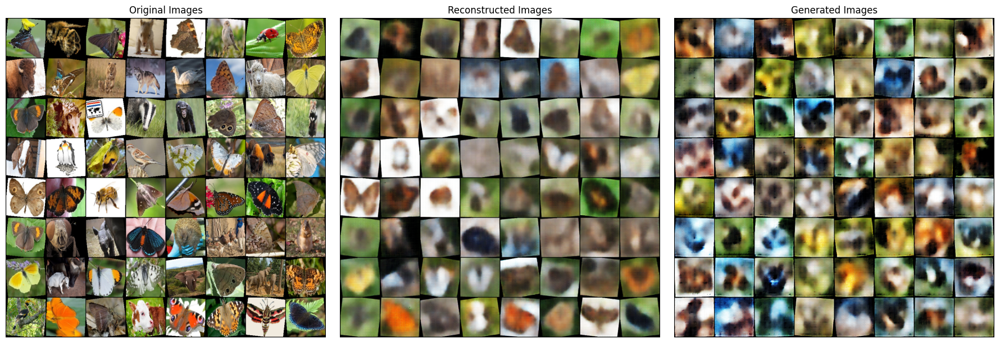

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('FID/model7Original.png', 'FID/model7Reconstruct.png', 'FID/model7Generated.png')


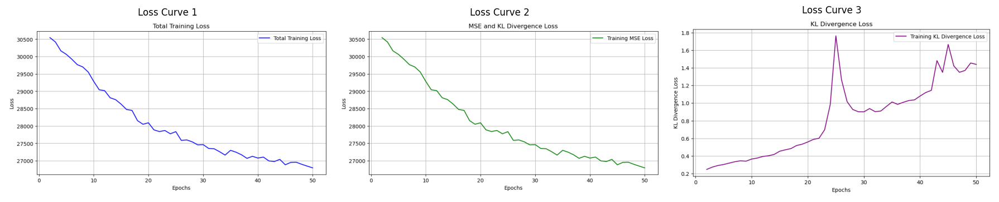

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('FID/model7Loss1.png', 'FID/model7Loss2.png', 'FID/model7Loss3.png')


Here is the FID Score
FID - 272.17 using our code
FID - 250.128 using Pytorch FID library

# Question 2 : CNN Classifier

**Since there are no labels for images in the test set, we will split the training set only for testing purposes.**

##### Importing necessary libraries seeing the data

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms, models
from PIL import Image
import os
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.models as models
import torch.optim as optim
import seaborn as sns
import pandas as pd
warnings.filterwarnings('ignore')

# Load the training set
train_csv_path = '/home/smehul/Desktop/archive/Training_set.csv'
train_df = pd.read_csv(train_csv_path)

# Display the first few rows of the DataFrame to understand its structure
print(train_df.head())

      filename                     label
0  Image_1.jpg          SOUTHERN DOGFACE
1  Image_2.jpg                    ADONIS
2  Image_3.jpg            BROWN SIPROETA
3  Image_4.jpg                   MONARCH
4  Image_5.jpg  GREEN CELLED CATTLEHEART



In [ ]:
# Get unique classes
unique_classes = train_df['label'].unique()

# Count the number of classes
num_classes = len(unique_classes)

print(f'Number of unique classes: {num_classes}')
print(f'Unique classes: {unique_classes}')


Number of unique classes: 75
Unique classes: ['SOUTHERN DOGFACE' 'ADONIS' 'BROWN SIPROETA' 'MONARCH'
 'GREEN CELLED CATTLEHEART' 'CAIRNS BIRDWING' 'EASTERN DAPPLE WHITE'
 'RED POSTMAN' 'MANGROVE SKIPPER' 'BLACK HAIRSTREAK' 'CABBAGE WHITE'
 'RED ADMIRAL' 'PAINTED LADY' 'PAPER KITE' 'SOOTYWING' 'PINE WHITE'
 'PEACOCK' 'CHECQUERED SKIPPER' 'JULIA' 'COMMON WOOD-NYMPH' 'BLUE MORPHO'
 'CLOUDED SULPHUR' 'STRAITED QUEEN' 'ORANGE OAKLEAF' 'PURPLISH COPPER'
 'ATALA' 'IPHICLUS SISTER' 'DANAID EGGFLY' 'LARGE MARBLE'
 'PIPEVINE SWALLOW' 'BLUE SPOTTED CROW' 'RED CRACKER' 'QUESTION MARK'
 'CRIMSON PATCH' 'BANDED PEACOCK' 'SCARCE SWALLOW' 'COPPER TAIL'
 'GREAT JAY' 'INDRA SWALLOW' 'VICEROY' 'MALACHITE' 'APPOLLO'
 'TWO BARRED FLASHER' 'MOURNING CLOAK' 'TROPICAL LEAFWING' 'POPINJAY'
 'ORANGE TIP' 'GOLD BANDED' 'BECKERS WHITE' 'RED SPOTTED PURPLE'
 'MILBERTS TORTOISESHELL' 'SILVER SPOT SKIPPER' 'AMERICAN SNOOT' 'AN 88'
 'ULYSES' 'COMMON BANDED AWL' 'CRECENT' 'METALMARK' 'SLEEPY ORANGE'
 'PURPLE HAIRSTREA

##### Checking number of unique classes in the dataset

In [ ]:
# Get unique classes
unique_classes = train_df['label'].unique()

# Count the number of classes
num_classes = len(unique_classes)

print(f'Number of unique classes: {num_classes}')
print(f'Unique classes: {unique_classes}')


Number of unique classes: 75
Unique classes: ['SOUTHERN DOGFACE' 'ADONIS' 'BROWN SIPROETA' 'MONARCH'
 'GREEN CELLED CATTLEHEART' 'CAIRNS BIRDWING' 'EASTERN DAPPLE WHITE'
 'RED POSTMAN' 'MANGROVE SKIPPER' 'BLACK HAIRSTREAK' 'CABBAGE WHITE'
 'RED ADMIRAL' 'PAINTED LADY' 'PAPER KITE' 'SOOTYWING' 'PINE WHITE'
 'PEACOCK' 'CHECQUERED SKIPPER' 'JULIA' 'COMMON WOOD-NYMPH' 'BLUE MORPHO'
 'CLOUDED SULPHUR' 'STRAITED QUEEN' 'ORANGE OAKLEAF' 'PURPLISH COPPER'
 'ATALA' 'IPHICLUS SISTER' 'DANAID EGGFLY' 'LARGE MARBLE'
 'PIPEVINE SWALLOW' 'BLUE SPOTTED CROW' 'RED CRACKER' 'QUESTION MARK'
 'CRIMSON PATCH' 'BANDED PEACOCK' 'SCARCE SWALLOW' 'COPPER TAIL'
 'GREAT JAY' 'INDRA SWALLOW' 'VICEROY' 'MALACHITE' 'APPOLLO'
 'TWO BARRED FLASHER' 'MOURNING CLOAK' 'TROPICAL LEAFWING' 'POPINJAY'
 'ORANGE TIP' 'GOLD BANDED' 'BECKERS WHITE' 'RED SPOTTED PURPLE'
 'MILBERTS TORTOISESHELL' 'SILVER SPOT SKIPPER' 'AMERICAN SNOOT' 'AN 88'
 'ULYSES' 'COMMON BANDED AWL' 'CRECENT' 'METALMARK' 'SLEEPY ORANGE'
 'PURPLE HAIRSTREA

## Butterfly Classification Model

In this project, we are using a **ResNet50-based convolutional neural network** for classifying butterfly images. The choice of ResNet50 as our model is due to its superior performance and ability to capture complex image features effectively. ResNet50 provides a deeper architecture compared to ResNet18, making it more suitable for handling intricate image patterns while maintaining manageable computational costs.

### Improving Model Accuracy

Initially, we observed around 60% accuracy on the test set with minimal data augmentation. To improve accuracy, we incorporated a more extensive data augmentation strategy, including transformations such as random rotations, horizontal and vertical flips, and color jittering. This additional augmentation helped the model generalize better, boosting test accuracy significantly. 

Additionally, a learning rate scheduler further improved accuracy by reducing the learning rate upon reaching a plateau. These enhancements collectively raised our test accuracy, demonstrating the effectiveness of data augmentation and scheduling. However, due to constraints requiring an input image size of only 128x128 pixels, our maximum achievable accuracy is capped. A larger input image size would have potentially improved accuracy even further, potentially reaching around 95%.

### Training and Evaluation Process

We train the model for a specified number of epochs (e.g., 100) and print validation metrics every 10 epochs to monitor the performance throughout training. For each training epoch, we save the best-performing model based on validation accuracy. 

After training, we plot:
1. **Loss Curves** – showing both training and validation loss over epochs, helping us visualize the convergence of the model.
2. **Accuracy Curves** – illustrating training and validation accuracy progression.
3. **Confusion Matrix** – providing insights into the model’s performance on each class.

This comprehensive evaluation approach ensures that we are effectively tracking both model performance and any signs of overfitting.



Using device: cuda
Starting training...
Epoch [1/100], Step [50/72], Loss: 3.2112

Epoch [1/100]:
Training Accuracy: 35.63%, Loss: 2.9202
Validation Accuracy: 48.05%, Loss: 2.3569
New best model saved with validation accuracy: 48.05%
Epoch [2/100], Step [50/72], Loss: 1.9551

Epoch [2/100]:
Training Accuracy: 62.43%, Loss: 1.9363
Validation Accuracy: 62.73%, Loss: 1.8778
New best model saved with validation accuracy: 62.73%
Epoch [3/100], Step [50/72], Loss: 1.7396

Epoch [3/100]:
Training Accuracy: 69.36%, Loss: 1.7201
Validation Accuracy: 71.87%, Loss: 1.6300
New best model saved with validation accuracy: 71.87%
Epoch [4/100], Step [50/72], Loss: 1.5941

Epoch [4/100]:
Training Accuracy: 74.32%, Loss: 1.5820
Validation Accuracy: 74.64%, Loss: 1.4872
New best model saved with validation accuracy: 74.64%
Epoch [5/100], Step [50/72], Loss: 1.4934

Epoch [5/100]:
Training Accuracy: 76.37%, Loss: 1.4985
Validation Accuracy: 76.18%, Loss: 1.4931
New best model saved with validation accurac

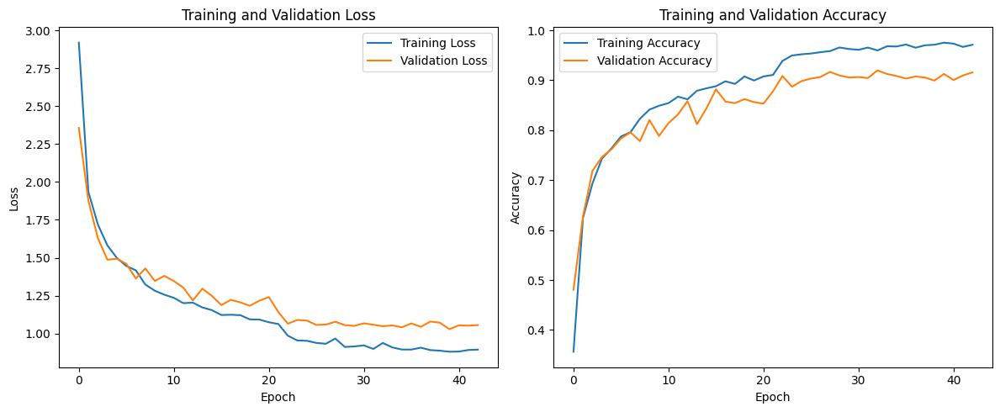

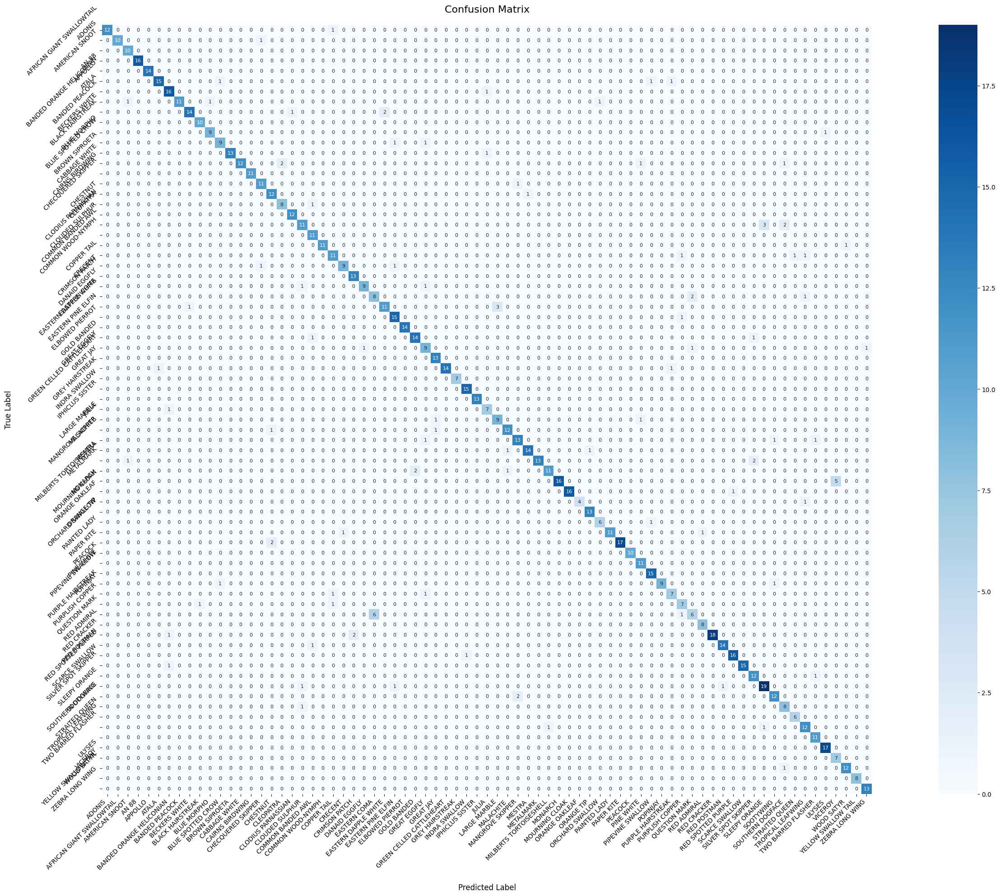


Final Test Set Classification Report:
                           precision    recall  f1-score   support

                   ADONIS       1.00      0.92      0.96        13
AFRICAN GIANT SWALLOWTAIL       1.00      0.91      0.95        11
           AMERICAN SNOOT       0.83      1.00      0.91        10
                    AN 88       1.00      1.00      1.00        16
                  APPOLLO       1.00      1.00      1.00        14
                    ATALA       0.94      0.83      0.88        18
 BANDED ORANGE HELICONIAN       0.84      0.94      0.89        17
           BANDED PEACOCK       1.00      0.79      0.88        14
            BECKERS WHITE       0.93      0.82      0.88        17
         BLACK HAIRSTREAK       0.91      1.00      0.95        10
              BLUE MORPHO       0.90      0.90      0.90        10
        BLUE SPOTTED CROW       0.82      0.82      0.82        11
           BROWN SIPROETA       1.00      0.93      0.96        14
            CABBAGE WH

In [ ]:
class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.data = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.classes = sorted(self.data['label'].unique())
        self.label_to_idx = {label: idx for idx, label in enumerate(self.classes)}
    
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.img_dir, self.data.iloc[idx]['filename'])
        image = Image.open(img_name).convert('RGB')
        label = self.label_to_idx[self.data.iloc[idx]['label']]
        
        if self.transform:
            image = self.transform(image)
            
        return image, label

class ImprovedButterflyClassifier(nn.Module):
    def __init__(self, num_classes):
        super(ImprovedButterflyClassifier, self).__init__()
        # Use a more powerful backbone - ResNet50 instead of ResNet18
        self.model = models.resnet50(pretrained=True)
        
        # Freeze early layers to prevent overfitting
        for param in list(self.model.parameters())[:-20]:
            param.requires_grad = False
            
        # Add dropout and batch normalization
        self.model.fc = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(self.model.fc.in_features, 512),
            nn.BatchNorm1d(512),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(512, num_classes)
        )
        
    def forward(self, x):
        return self.model(x)
def evaluate_model(model, data_loader, criterion, device):
    model.eval()
    total_loss = 0
    predictions = []
    true_labels = []
    
    with torch.no_grad():
        for images, labels in data_loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            loss = criterion(outputs, labels)
            total_loss += loss.item()
            
            _, predicted = torch.max(outputs.data, 1)
            predictions.extend(predicted.cpu().numpy())
            true_labels.extend(labels.cpu().numpy())
    
    accuracy = accuracy_score(true_labels, predictions)
    return accuracy, total_loss/len(data_loader), predictions, true_labels

import warnings
warnings.filterwarnings('ignore')
import torch.nn as nn
import torchvision.transforms as transforms
from torch.utils.data import Dataset, DataLoader, random_split
import torchvision.models as models
import torch.optim as optim
import matplotlib.pyplot as plt

# Rest of the imports remain same...

def train_model(model, train_loader, val_loader, test_loader, criterion, optimizer, device, num_epochs=100):
    best_val_acc = 0.0
    best_model_state = None
    train_accuracies = []
    val_accuracies = []
    train_losses = []
    val_losses = []
    
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=5, verbose=True)
    patience = 10
    counter = 0
    
    for epoch in range(num_epochs):
        # Training phase
        model.train()
        running_loss = 0.0
        train_predictions = []
        train_true_labels = []
        epoch_train_loss = 0.0
        
        for i, (images, labels) in enumerate(train_loader):
            images, labels = images.to(device), labels.to(device)
            
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            
            optimizer.step()
            
            running_loss += loss.item()
            epoch_train_loss += loss.item()
            _, predicted = torch.max(outputs.data, 1)
            train_predictions.extend(predicted.cpu().numpy())
            train_true_labels.extend(labels.cpu().numpy())
            
            if (i + 1) % 50 == 0:
                print(f'Epoch [{epoch+1}/{num_epochs}], Step [{i+1}/{len(train_loader)}], '
                      f'Loss: {running_loss/50:.4f}')
                running_loss = 0.0
        
        # Calculate average training loss for the epoch
        avg_train_loss = epoch_train_loss / len(train_loader)
        train_losses.append(avg_train_loss)
        
        train_acc = accuracy_score(train_true_labels, train_predictions)
        train_accuracies.append(train_acc)
        
        # Validation phase
        val_acc, val_loss, val_pred, val_true = evaluate_model(model, val_loader, criterion, device)
        val_accuracies.append(val_acc)
        val_losses.append(val_loss)
        
        scheduler.step(val_acc)
        
        print(f'\nEpoch [{epoch+1}/{num_epochs}]:')
        print(f'Training Accuracy: {train_acc*100:.2f}%, Loss: {avg_train_loss:.4f}')
        print(f'Validation Accuracy: {val_acc*100:.2f}%, Loss: {val_loss:.4f}')
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            best_model_state = model.state_dict().copy()
            counter = 0
            print(f'New best model saved with validation accuracy: {val_acc*100:.2f}%')
        else:
            counter += 1
            if counter >= patience:
                print("Early stopping triggered")
                break
    
    # Load best model and evaluate on test set
    print("\nLoading best model for final evaluation...")
    model.load_state_dict(best_model_state)
    test_acc, test_loss, test_pred, test_true = evaluate_model(model, test_loader, criterion, device)
    
    # Plot final learning curves
    plt.figure(figsize=(12, 5))
    
    # Plot losses
    plt.subplot(1, 2, 1)
    plt.plot(train_losses, label='Training Loss')
    plt.plot(val_losses, label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    # Plot accuracies
    plt.subplot(1, 2, 2)
    plt.plot(train_accuracies, label='Training Accuracy')
    plt.plot(val_accuracies, label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.tight_layout()
    plt.show()
    
    # Plot final confusion matrix
    plt.figure(figsize=(30, 20))  # Increased figure size significantly

    # Create confusion matrix
    cm = confusion_matrix(test_true, test_pred)

    # Create heatmap with improved visibility
    sns.heatmap(cm, 
        annot=True,
        fmt='d',
        cmap='Blues',# Load and preprocess the image
image = Image.open(imagepath).convert("RGB")  # Ensure image is in RGB format
image = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to device

# Get the latent vector using the VAE
with torch.no_grad():
    encoded = vae.encoder(image)
    mu = vae.mean(encoded)
    logvar = vae.logvar(encoded)
    latent_vector = sample_latent_variable(mu, logvar)
    
# Make a prediction
prediction = predict_with_labels(model, latent_vector)
print("Prediction:", prediction[0])
        xticklabels=full_dataset.classes,
        yticklabels=full_dataset.classes,
        annot_kws={'size': 8},
        square=True 
    )
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(rotation=45, ha='right', fontsize=10)

    # Adjust label positions
    plt.title('Confusion Matrix', pad=20, fontsize=16)
    plt.ylabel('True Label', labelpad=20, fontsize=12)
    plt.xlabel('Predicted Label', labelpad=20, fontsize=12)

    # Adjust layout to prevent label cutoff
    plt.tight_layout()

    plt.show()
    print("\nFinal Test Set Classification Report:")
    print(classification_report(test_true, test_pred, target_names=full_dataset.classes))
    
    return model, test_acc, train_losses, val_losses, train_accuracies, val_accuracies



def main():
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    torch.manual_seed(42)
    print(f"Using device: {device}")
    
    # Define transforms
    train_transform = transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.RandomRotation(15),
        transforms.RandomHorizontalFlip(),
        transforms.RandomVerticalFlip(),
        transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
        transforms.RandomAffine(degrees=0, translate=(0.1, 0.1), scale=(0.9, 1.1)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                           std=[0.229, 0.224, 0.225])
    ])
    
    val_transform = transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.CenterCrop(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                           std=[0.229, 0.224, 0.225])
    ])
    
    # Create full dataset first
    global full_dataset
    full_dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Training_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=val_transform
    )
    
    # Create train dataset with training transforms
    train_dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Training_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=train_transform
    )
    
    # Calculate splits
    total_size = len(train_dataset)
    train_size = int(0.7 * total_size)
    val_size = int(0.15 * total_size)
    test_size = total_size - train_size - val_size
    
    # Split dataset
    generator = torch.Generator().manual_seed(42)
    train_data, val_data, test_data = random_split(
        train_dataset, 
        [train_size, val_size, test_size],
        generator=generator
    )
    
    # Create data loaders
    train_loader = DataLoader(train_data, batch_size=64, shuffle=True, num_workers=4, pin_memory=True)
    val_loader = DataLoader(val_data, batch_size=64, shuffle=False, num_workers=4, pin_memory=True)
    test_loader = DataLoader(test_data, batch_size=64, shuffle=False, num_workers=4, pin_memory=True)
    
    # Initialize model and training components
    model = ImprovedButterflyClassifier(num_classes=len(full_dataset.classes)).to(device)
    criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01)
    
    print("Starting training...")
    model, test_accuracy, train_losses, val_losses, train_accuracies, val_accuracies = train_model(
        model, train_loader, val_loader, test_loader, 
        criterion, optimizer, device, num_epochs=100
    )
    
    print(f"\nTraining completed! Final test accuracy: {test_accuracy*100:.2f}%")

if __name__ == "__main__":
    main()

#### The test accuracy is around 90% with the current model and data augmentation strategy. I think it's pretty good considering the constraints and the dataset size.
#### The training and validation loss and accuracy curves are as expected. The model is not overfitting, and the accuracy is increasing with epochs. The confusion matrix shows that the model is performing well on most classes, with some confusion between similar classes.

# Question 3: MLP Classifier using posterior inference

Here is the code to load the model weights

In [ ]:
import torch
import os
from torchvision.utils import save_image
from torchvision.transforms import transforms
from PIL import Image
import torch.nn as nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

class VariationalAutoEncoder(nn.Module):
    
    def __init__(self):
        super(VariationalAutoEncoder, self).__init__()
        
        # Make encoder to accept 128x128 images across 3 channels
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=8, kernel_size=3, stride=2, padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride=2, padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=2, padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=2, padding=1), # 8x8
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.Flatten(),
            nn.Linear(64*8*8, 64*4*4),
            nn.ReLU(),
            nn.Linear(64*4*4, 256),
            
        )
        
        # mean and log variance
        self.mean = nn.Linear(256, 128)
        self.logvar = nn.Linear(256, 128)
        
        # decoder
        self.decoder = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, 64*8*8),
            nn.ReLU(),
            nn.Unflatten(1, (64, 8, 8)),
            
            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=32, out_channels=16, kernel_size=3, stride=2, padding=1, output_padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=16, out_channels=8, kernel_size=3, stride=2, padding=1, output_padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, padding=1, output_padding=1), # 128x128
            nn.Tanh()
        )
        
    def reparameterize(self, mean, logvar,num_latents):
        
        z = []
        for i in range(num_latents):
            std = torch.exp(0.5*logvar)
            eps = torch.randn_like(std)
            z.append(eps.mul(std).add_(mean))
            
        latentMean = 0
        for i in range(num_latents):
            latentMean += z[i]
        latentMean = latentMean/num_latents
        
        return latentMean
    
    def forward(self, x):
        x = self.encoder(x)
        mean = self.mean(x)
        logvar = self.logvar(x)
        num_latents = 1
        z = self.reparameterize(mean, logvar,num_latents)
        x = self.decoder(z)
        return x, mean, logvar
    
# Create an instance of the VariationalAutoEncoder
vae = VariationalAutoEncoder().to(device)

# Load the saved weights
vae.load_state_dict(torch.load('model5.pth'))
vae.eval()  # Set the model to evaluation mode

Code to Generate latents

In [ ]:
import pandas as pd
import numpy as np

# Define the path to your image directory and the CSV file
image_dir = 'ImagesD/train/'
csv_file = 'Training_set.csv'

# Load the CSV file
data = pd.read_csv(csv_file)

# Initialize a list to hold latent vectors and their corresponding labels
latent_vectors = []
labels = []

# Define the image transformation
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalize based on your training setup
])

# Function to sample latent variable z
def sample_latent_variable(mu, logvar):
    std = torch.exp(0.5 * logvar)
    eps = torch.randn_like(std)  # Random noise
    return eps * std + mu  # Reparameterization trick

# Process each image
for index, row in data.iterrows():
    filename = row['filename']
    label = row['label']
    
    # Construct the full image path
    image_path = os.path.join(image_dir, filename)
    
    # Load and preprocess the image
    image = Image.open(image_path).convert("RGB")  # Ensure image is in RGB format
    image = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to device
    
    # Get the latent vector using the VAE
    with torch.no_grad():
        encoded = vae.encoder(image)
        mu = vae.mean(encoded)
        logvar = vae.logvar(encoded)
        latent_vector = sample_latent_variable(mu, logvar)
    
    # Append the latent vector and label to the lists
    latent_vectors.append(latent_vector.cpu().numpy())  # Convert to numpy and move to CPU
    labels.append(label)

# Convert lists to numpy arrays for easier manipulation later
latent_vectors = np.array(latent_vectors)
labels = np.array(labels)

# Print the shape of the collected data
print(f'Collected {latent_vectors.shape[0]} latent vectors with shape {latent_vectors.shape[1:]}.')
print(f'Labels: {np.unique(labels)}')  # Print unique labels for verification

Label Encoding and making train and validation loaders

In [ ]:
# Convert labels to numerical values
label_to_idx = {label: idx for idx, label in enumerate(np.unique(labels))}
numerical_labels = np.array([label_to_idx[label] for label in labels])

# Create a custom Dataset class
class LatentDataset(Dataset):
    def __init__(self, latent_vectors, labels):
        self.latent_vectors = latent_vectors
        self.labels = labels
        
    def __len__(self):
        return len(self.labels)
    
    def __getitem__(self, idx):
        return torch.FloatTensor(self.latent_vectors[idx]), self.labels[idx]

# Create Dataset
dataset = LatentDataset(latent_vectors, numerical_labels)

# Define sizes for train and validation datasets
train_size = int(0.8 * len(dataset))
val_size = len(dataset) - train_size

# Split the dataset into training and validation
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Create DataLoaders for the training and validation datasets
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Optionally, print the sizes of the datasets to verify
print(f'Training dataset size: {len(train_loader.dataset)}')
print(f'Validation dataset size: {len(val_loader.dataset)}')

Making Tensor Dataset, defining MLP and Training LOOp


In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from tqdm import tqdm
import numpy as np

# Encode the string labels
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)

# Save the label encoder for future use
import joblib
joblib.dump(label_encoder, 'label_encoder.joblib')

# Convert numpy arrays to PyTorch tensors
X = torch.FloatTensor(latent_vectors.reshape(latent_vectors.shape[0], -1))  # Flatten the latent vectors
y = torch.LongTensor(encoded_labels)

print(f"Number of classes: {len(label_encoder.classes_)}")
print(f"Sample of encoded labels: {encoded_labels[:5]}")
print(f"Corresponding original labels: {labels[:5]}")

# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Create data loaders
batch_size = 32
train_dataset = TensorDataset(X_train, y_train)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataset = TensorDataset(X_val, y_val)
val_loader = DataLoader(val_dataset, batch_size=batch_size)

class MLPClassifier(nn.Module):
    def __init__(self, input_dim=128, hidden_dims=[256, 512, 256], num_classes=75, dropout_rate=0.3):
        super(MLPClassifier, self).__init__()
        
        layers = []
        # Input layer
        layers.append(nn.Linear(input_dim, hidden_dims[0]))
        layers.append(nn.ReLU())
        layers.append(nn.BatchNorm1d(hidden_dims[0]))
        layers.append(nn.Dropout(dropout_rate))
        
        # Hidden layers
        for i in range(len(hidden_dims)-1):
            layers.append(nn.Linear(hidden_dims[i], hidden_dims[i+1]))
            layers.append(nn.ReLU())
            layers.append(nn.BatchNorm1d(hidden_dims[i+1]))
            layers.append(nn.Dropout(dropout_rate))
        
        # Output layer
        layers.append(nn.Linear(hidden_dims[-1], num_classes))
        
        self.model = nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

# Initialize model, loss function, and optimizer
model = MLPClassifier(num_classes=len(label_encoder.classes_)).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)

def train_epoch(model, train_loader, criterion, optimizer):
    model.train()
    total_loss = 0
    correct = 0
    total = 0
    
    progress_bar = tqdm(train_loader, desc='Training')
    for inputs, targets in progress_bar:
        inputs, targets = inputs.to(device), targets.to(device)
        
        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, targets)
        
        loss.backward()
        optimizer.step()
        
        total_loss += loss.item()
        _, predicted = outputs.max(1)
        total += targets.size(0)
        correct += predicted.eq(targets).sum().item()
        
        # Update progress bar
        progress_bar.set_postfix({
            'loss': f'{total_loss/len(progress_bar):.4f}',
            'acc': f'{100.*correct/total:.2f}%'
        })
    
    return total_loss/len(train_loader), correct/total

def validate(model, val_loader, criterion):
    model.eval()
    total_loss = 0
    correct = 0
    total = 0
    
    with torch.no_grad():
        for inputs, targets in val_loader:
            inputs, targets = inputs.to(device), targets.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, targets)
            
            total_loss += loss.item()
            _, predicted = outputs.max(1)
            total += targets.size(0)
            correct += predicted.eq(targets).sum().item()
    
    return total_loss/len(val_loader), correct/total

# Function to predict with original label names
def predict_with_labels(model, input_tensor):
    model.eval()
    with torch.no_grad():
        output = model(input_tensor.to(device))
        _, predicted = output.max(1)
        return label_encoder.inverse_transform(predicted.cpu().numpy())

# Training loop
num_epochs = 50
best_val_acc = 0
patience = 10
patience_counter = 0

print("Starting training...")
for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")
    
    # Training phase
    train_loss, train_acc = train_epoch(model, train_loader, criterion, optimizer)
    
    # Validation phase
    val_loss, val_acc = validate(model, val_loader, criterion)
    
    print(f"Train Loss: {train_loss:.4f} | Train Acc: {train_acc*100:.2f}%")
    print(f"Val Loss: {val_loss:.4f} | Val Acc: {val_acc*100:.2f}%")
    
    # Learning rate scheduling
    scheduler.step(val_loss)
    


Here are the results obtained when we run for 200 epochs and training was stopped using early stopping on 32 epochs


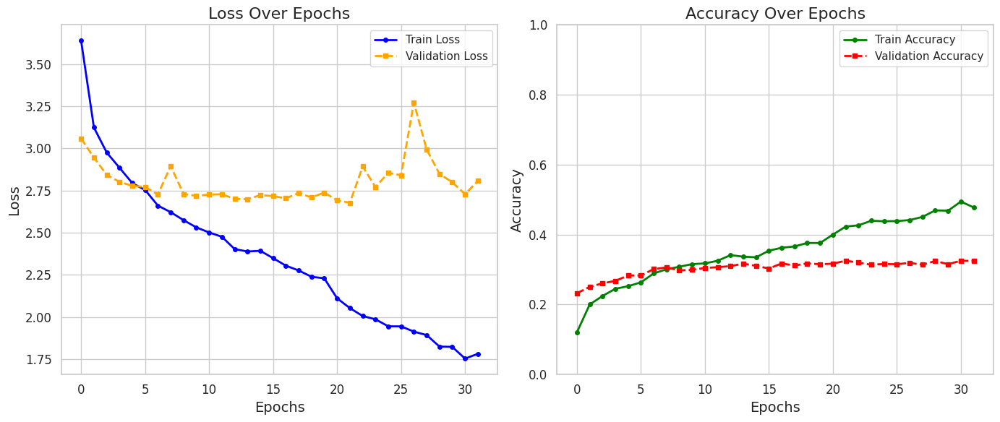

In [ ]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='ImagesF/mlp1.png'))


We are getting Validation Accuracy of 32.46% and Training Accuracy of 47.78%

However, when we run the training further, training accuracy increases which means model is overfitting

Here are the results when we do not use early stopping and run for 200 epochs

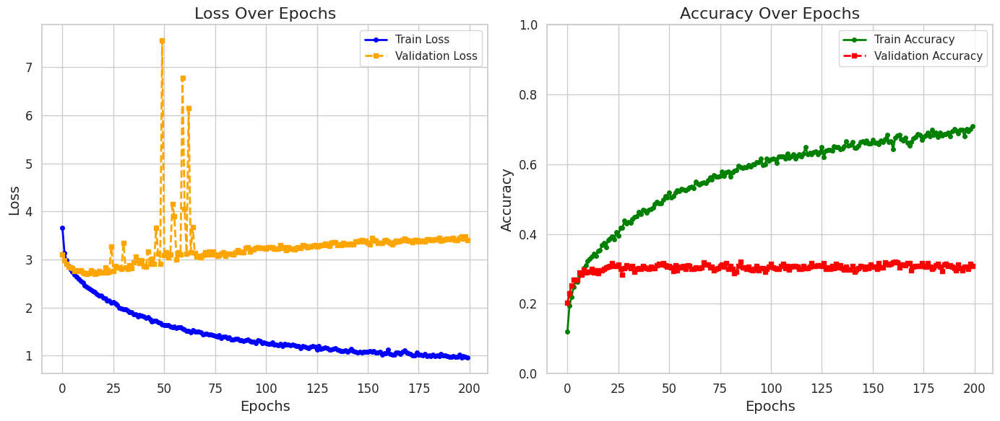

In [ ]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='ImagesF/mlp2.png'))


Here is how we can make the prediction on new dataset

In [ ]:
# Test on new image
imagepath = 'ImagesE/test/Image_1.jpg'

In [ ]:
# Load and preprocess the image
image = Image.open(imagepath).convert("RGB")  # Ensure image is in RGB format
image = transform(image).unsqueeze(0).to(device)  # Add batch dimension and move to device

# Get the latent vector using the VAE
with torch.no_grad():
    encoded = vae.encoder(image)
    mu = vae.mean(encoded)
    logvar = vae.logvar(encoded)
    latent_vector = sample_latent_variable(mu, logvar)
    
# Make a prediction
prediction = predict_with_labels(model, latent_vector)
print("Prediction:", prediction[0])

### Classification with VAE Latent Space

Using latent vectors from a Variational Autoencoder (VAE) as input to an MLP for classification achieved 33% accuracy. Here’s a concise look at the pros and cons.

### Advantages
•⁠  ⁠*Dimensionality Reduction*: Latent space reduces input size, lowering MLP complexity and computational cost.
•⁠  ⁠*Feature Extraction*: Captures key data features, potentially boosting performance on small datasets.
•⁠  ⁠*Regularization*: Smooths data representation, which may improve generalization.

### Disadvantages
•⁠  ⁠*Information Loss*: Compression may strip critical details, reducing classification accuracy.
•⁠  ⁠*Lower Accuracy*: 33% accuracy indicates latent features may lack enough class-specific information.
•⁠  ⁠*Added Complexity*: Requires pre-trained VAE, complicating the training pipeline.

### Summary
Latent space simplifies input and aids generalization but risks lower accuracy. Balancing dimensionality with sufficient detail is crucial.

# Question 4: Beta VAE

### Model 1 with following loss function, beta = 0.01 and Reconstruction Loss Multiplier = 0.1 to bring losses to lower scales 

In [ ]:
def lossFunction(reconX, X, mean, logVariance):
    mseLoss = F.mse_loss(reconX, X, reduction='sum')
    KLdivergenceLoss = torch.mean(-0.5 * torch.sum(1 + logVariance - mean.pow(2) - logVariance.exp(), dim = 1), dim = 0)
    return [0.1*mseLoss + 0.01*KLdivergenceLoss, 0.1*mseLoss, 0.01*KLdivergenceLoss]

Here are the results obtained

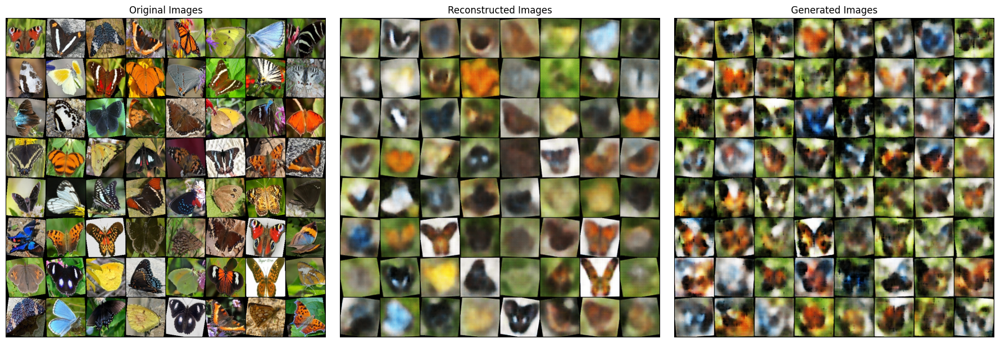

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model4Original.png', 'ImagesF/Model4Reconstruct.png', 'ImagesF/model4Generate.png')


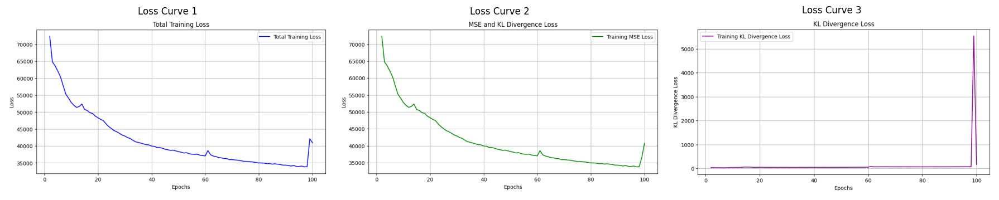

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model4Loss1.png', 'ImagesF/model4Loss2.png', 'ImagesF/model4Loss3.png')


### Model 2 with following loss function, beta = 0.001 and Reconstruction Loss Multiplier = 0.1 to bring losses to lower scales

In [ ]:
def lossFunction(reconX, X, mean, logVariance):
    mseLoss = F.mse_loss(reconX, X, reduction='sum')
    KLdivergenceLoss = torch.mean(-0.5 * torch.sum(1 + logVariance - mean.pow(2) - logVariance.exp(), dim = 1), dim = 0)
    return [0.1*mseLoss + 0.001*KLdivergenceLoss, 0.1*mseLoss, 0.001*KLdivergenceLoss]

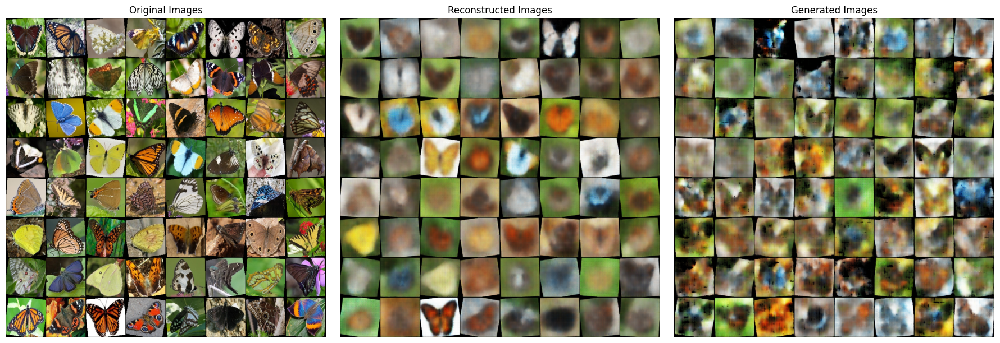

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model5original.png', 'ImagesF/model5reconstruct.png', 'ImagesF/model5generated.png')


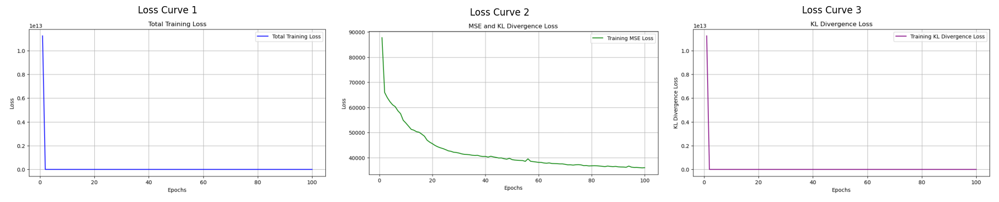

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model5Loss1.png', 'ImagesF/model5Loss2.png', 'ImagesF/model5Loss3.png')


We can see that the loss started from very high value and then decreased to very low value, we can zoom in to see that

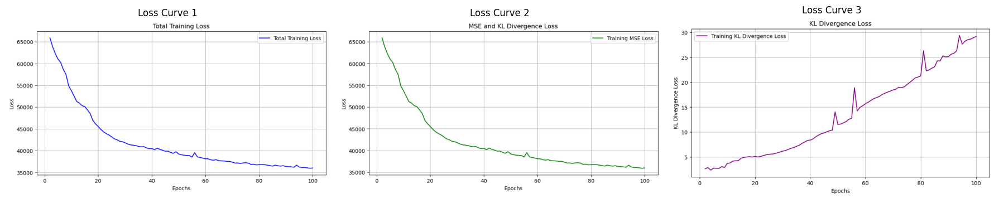

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model5Loss4.png', 'ImagesF/model5Loss5.png', 'ImagesF/model5Loss6.png')


### Model 3 with following loss function, beta = 2 and Reconstruction Loss Multiplier = 0.001 to bring losses to lower scales

In [ ]:
def lossFunction(reconX, X, mean, logVariance):
    mseLoss = F.mse_loss(reconX, X, reduction='sum')
    KLdivergenceLoss = torch.mean(-0.5 * torch.sum(1 + logVariance - mean.pow(2) - logVariance.exp(), dim = 1), dim = 0)
    return [0.001*mseLoss + 2*KLdivergenceLoss, 0.001*mseLoss, 2*KLdivergenceLoss]

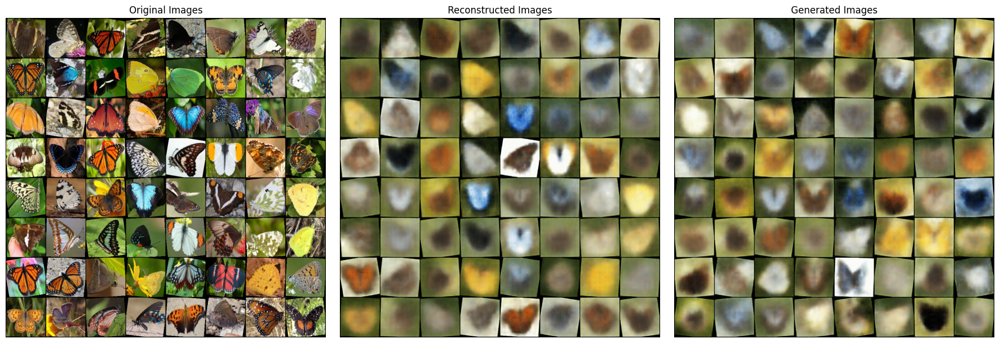

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model6Original.png', 'ImagesF/model6Reconstruct.png', 'ImagesF/model6Generated.png')


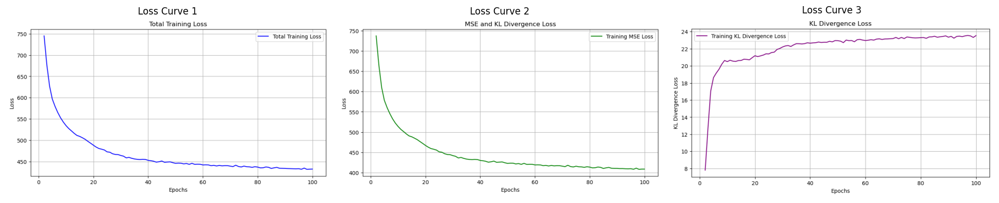

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model6Loss1.png', 'ImagesF/model6Loss2.png', 'ImagesF/model6Loss3.png')


### Model 4 with following loss function, beta = 5 and Reconstruction Loss Multiplier = 1 to bring losses to lower scales

In [ ]:
def lossFunction(reconX, X, mean, logVariance):
    mseLoss = F.mse_loss(reconX, X, reduction='sum')
    KLdivergenceLoss = torch.mean(-0.5 * torch.sum(1 + logVariance - mean.pow(2) - logVariance.exp(), dim = 1), dim = 0)
    return [1*mseLoss + 5*KLdivergenceLoss, 1*mseLoss, 5*KLdivergenceLoss]

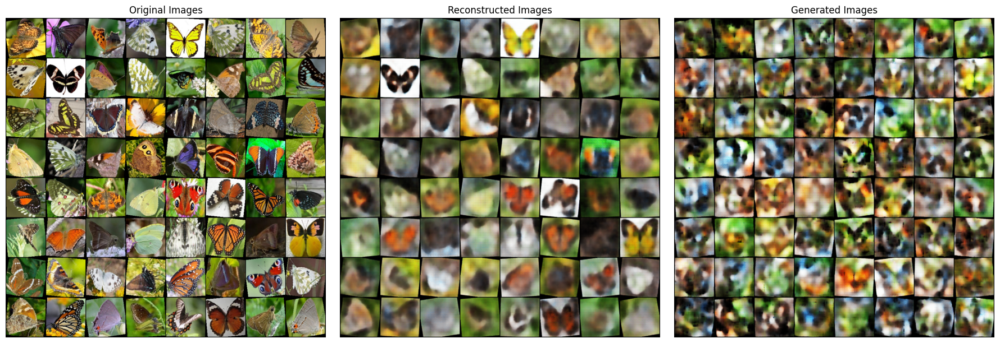

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Original Images")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Reconstructed Images")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Generated Images")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model7Original.png', 'ImagesF/model7Reconstruct.png', 'ImagesF/model7Generated.png')


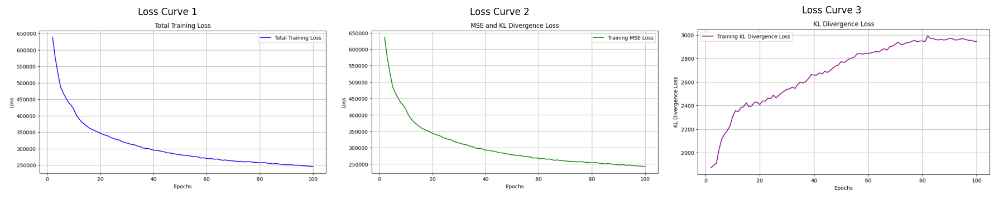

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_three_way(image1_path, image2_path, image3_path):
    # Load images
    img1 = mpimg.imread(image1_path)
    img2 = mpimg.imread(image2_path)
    img3 = mpimg.imread(image3_path)

    # Create figure and subplots
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))

    # Display the first image
    axes[0].imshow(img1)
    axes[0].set_title("Loss Curve 1")
    axes[0].axis('off')  # Hide axes for a cleaner look

    # Display the second image
    axes[1].imshow(img2)
    axes[1].set_title("Loss Curve 2")
    axes[1].axis('off')  # Hide axes for a cleaner look

    # Display the third image
    axes[2].imshow(img3)
    axes[2].set_title("Loss Curve 3")
    axes[2].axis('off')  # Hide axes for a cleaner look

    plt.tight_layout()
    plt.show()

# Call the function with file paths
plot_images_three_way('ImagesF/model7Loss1.png', 'ImagesF/model7Loss2.png', 'ImagesF/model7Loss3.png')


### Observations
1. When Beta = 0.1 and 0.001 as in 1st and 2nd Case, we can observe resonstruction is very good as compared to generation.
2. When Beta = 2 in 3rd case, generation as well as re-construction is almost same
3. When Beta = 5 is choosen with Reconstruction Loss Multiplier = 1, reconstruction again looks good as compared to generation
4. KL Loss kept increasing in all 4 cases, I tried tuning KL Loss Multiplier (BETA) and Reconstruction Loss Multiplier but still it remained same.

## FID Scores
Again we computed FID using Pytorch FID library and also from scratch using the below code

**Model 1**
1. FID - 358.31 using our code
2. FID - 264.77 using Pytorch FID library

**Model 2**
1. FID - 336.82 using our code
2. FID - 277.85 using Pytorch FID library

**Model 3**
1. FID - 299.59 using our code
2. FID - 307.43 using Pytorch FID library

**Model 4**
1. FID - 300.11 using our code
2. FID - 346.71 using Pytorch FID library



# Question 5: Posterior Inference

We will Proceed with Model 1 and Model 3 because of Best FID from Pytorch Library 

In [ ]:
import torch
import os
from torchvision.utils import save_image
from torchvision.transforms import transforms
from PIL import Image
import torch.nn as nn

device = "cuda" if torch.cuda.is_available() else "cpu"
print('Using device:', device)

class VariationalAutoEncoder(nn.Module):
    
    def __init__(self):
        super(VariationalAutoEncoder, self).__init__()
        
        # Make encoder to accept 128x128 images across 3 channels
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=8, kernel_size=3, stride=2, padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride=2, padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=2, padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=2, padding=1), # 8x8
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.Flatten(),
            nn.Linear(64*8*8, 64*4*4),
            nn.ReLU(),
            nn.Linear(64*4*4, 256),
            
        )
        
        # mean and log variance
        self.mean = nn.Linear(256, 128)
        self.logvar = nn.Linear(256, 128)
        
        # decoder
        self.decoder = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, 64*8*8),
            nn.ReLU(),
            nn.Unflatten(1, (64, 8, 8)),
            
            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=32, out_channels=16, kernel_size=3, stride=2, padding=1, output_padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=16, out_channels=8, kernel_size=3, stride=2, padding=1, output_padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, padding=1, output_padding=1), # 128x128
            nn.Tanh()
        )
        
    def reparameterize(self, mean, logvar,num_latents):
        
        z = []
        for i in range(num_latents):
            std = torch.exp(0.5*logvar)
            eps = torch.randn_like(std)
            z.append(eps.mul(std).add_(mean))
            
        latentMean = 0
        for i in range(num_latents):
            latentMean += z[i]
        latentMean = latentMean/num_latents
        
        return latentMean
    
    def forward(self, x):
        x = self.encoder(x)
        mean = self.mean(x)
        logvar = self.logvar(x)
        num_latents = 1
        z = self.reparameterize(mean, logvar,num_latents)
        x = self.decoder(z)
        return x, mean, logvar
    
# Create an instance of the VariationalAutoEncoder
vae = VariationalAutoEncoder().to(device)

# Load the saved weights
vae.load_state_dict(torch.load('model4.pth'))
vae.eval()  # Set the model to evaluation mode

images = [f'ImagesD/train/Image_{i}.jpg' for i in range(1, 21)]

# Load and preprocess the image
def load_and_preprocess_image(image_path):
    transform = transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    ])
    image = Image.open(image_path).convert("RGB")
    return transform(image).unsqueeze(0).to(device)

# Apply the Transform to the image
images = [load_and_preprocess_image(image) for image in images]



In the above code we are loading model weights and architecture to get the latents

In [ ]:
# Function to sample latent variable z
def sample_latent_variable(mu, logvar):
    std = torch.exp(0.5 * logvar)
    eps = torch.randn_like(std)  # Random noise
    return eps * std + mu  # Reparameterization trick

with torch.no_grad():
    latents = []
    for i in images:
        encoded = vae.encoder(i)
        mean = vae.mean(encoded)
        logvar = vae.logvar(encoded)
        
        z = sample_latent_variable(mean, logvar)
        latents.append(z)

allInterpolatedImages = []
import numpy as np
for i in range(10):
    
    z1 = latents[2*i]
    z2 = latents[2*i+1]
    
    interpolated_images = []
    
    for alpha in np.linspace(0, 1, 10):
        zInterpolated = alpha * z1 + (1 - alpha) * z2
        image = vae.decoder(zInterpolated)
        interpolated_images.append(image)
    
    allInterpolatedImages.append(interpolated_images)
    
import matplotlib.pyplot as plt

# Number of pairs (you've processed 10 pairs)
num_pairs = len(allInterpolatedImages)
num_interpolations = len(allInterpolatedImages[0])  # Assuming all have the same number of interpolations

# Create a figure with subplots
fig, axes = plt.subplots(num_pairs, num_interpolations, figsize=(25, num_pairs * 3))

# Loop through each pair of interpolated images and plot
for i, interpolated_images in enumerate(allInterpolatedImages):
    for j, image in enumerate(interpolated_images):
        # Unnormalize the image to [0, 1] range if it was normalized before
        img = image.squeeze(0).detach().cpu()  # Remove batch dimension and move to CPU
        img = img * 0.5 + 0.5  # Adjust if you normalized earlier
        
        # Plot the image
        axes[i, j].imshow(img.permute(1, 2, 0).numpy())  # Permute to get channels last
        axes[i, j].axis('off')  # Hide axis ticks and labels

# Set titles for each row if desired
for i in range(num_pairs):
    axes[i, 0].set_ylabel(f'Pair {2*i + 1} & {2*i + 2}', fontsize=12)

plt.tight_layout()  # Adjust layout to prevent overlap
plt.show()


Here are the results obtained

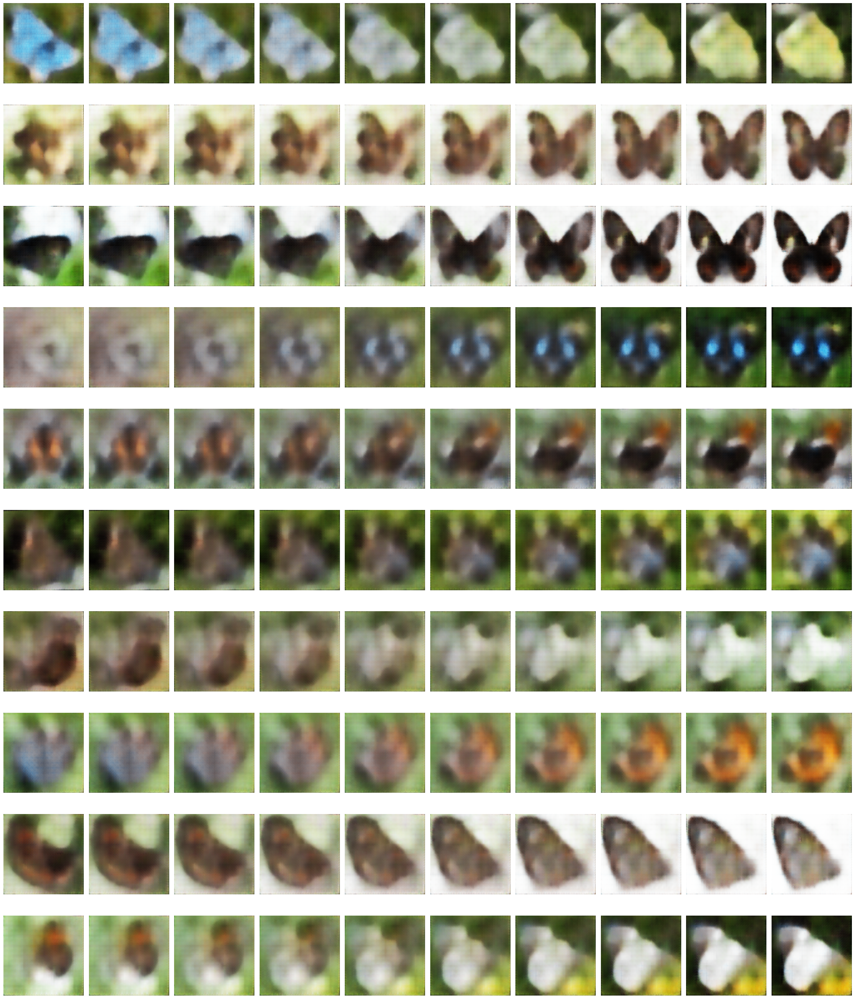

In [ ]:
from IPython.display import Image
from IPython.display import display

display(Image(filename='ImagesF/Interpolation.png'))


# Question 6: Adversarial Auto-encoder with MSE loss

##### Defining the modules and dataset class

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
import pandas as pd
from PIL import Image
import os
import numpy as np
import matplotlib.pyplot as plt
from torch.utils.data import TensorDataset
import torch.nn.functional as F
from torchvision.models import inception_v3
from scipy import linalg
class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.annotations = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform

    def __len__(self):
        return len(self.annotations)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.annotations.iloc[idx, 0])
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
        
        return image


##### The model has three main parts:
##### Encoder: Converts images into a low-dimensional latent representation.
##### Decoder: Reconstructs images from the latent space.
##### Discriminator: Distinguishes real latent samples from fake ones generated by the encoder.

In [ ]:
class AdversarialAutoEncoder(nn.Module):
    def __init__(self):
        super(AdversarialAutoEncoder, self).__init__()
        
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=8, kernel_size=3, stride=2, padding=1), # 64x64
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=8, out_channels=16, kernel_size=3, stride=2, padding=1), # 32x32
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=3, stride=2, padding=1), # 16x16
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=3, stride=2, padding=1), # 8x8
            nn.BatchNorm2d(64),
            nn.ReLU(),
            
            nn.Flatten(),
            nn.Linear(64*8*8, 64*4*4),
            nn.ReLU(),
            nn.Linear(64*4*4, 128)  # latent space dimension
        )
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(128, 256),
            nn.ReLU(),
            nn.Linear(256, 64*8*8),
            nn.ReLU(),
            nn.Unflatten(1, (64, 8, 8)),
            
            nn.ConvTranspose2d(in_channels=64, out_channels=32, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=32, out_channels=16, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(16),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=16, out_channels=8, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.ReLU(),
            
            nn.ConvTranspose2d(in_channels=8, out_channels=3, kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.Tanh()
        )
        
        # Discriminator
        self.discriminator = nn.Sequential(
            nn.Linear(128, 512),
            nn.LeakyReLU(0.2),
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )
    
    def encode(self, x):
        return self.encoder(x)
    
    def decode(self, z):
        return self.decoder(z)
    
    def discriminate(self, z):
        return self.discriminator(z)
    
    def forward(self, x):
        z = self.encode(x)
        x_recon = self.decode(z)
        return x_recon, z

This class extracts features from the InceptionV3 model, which are used for calculating the FID score to measure the quality of generated images.



In [ ]:
class InceptionFeatureExtractor(nn.Module):
    def __init__(self):
        super().__init__()
        self.inception = inception_v3(pretrained=True)
        self.inception.fc = nn.Identity()
        self.inception.eval()
        
    def forward(self, x):
        x = F.interpolate(x, size=(299, 299), mode='bilinear', align_corners=False)
        with torch.no_grad():
            features = self.inception(x)
        return features


We have here a function which calculates the FID score and another function which uses the class defined above to get the inception features of the real and generated images and then calculates the FID score.

In [ ]:
def calculate_fid(real_features, fake_features):
    mu1, sigma1 = real_features.mean(axis=0), np.cov(real_features, rowvar=False)
    mu2, sigma2 = fake_features.mean(axis=0), np.cov(fake_features, rowvar=False)
    
    ssdiff = np.sum((mu1 - mu2) ** 2.0)
    covmean = linalg.sqrtm(sigma1.dot(sigma2))
    
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    
    fid = ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

def get_inception_features(dataloader, device):
    feature_extractor = InceptionFeatureExtractor().to(device)
    features_list = []
    
    with torch.no_grad():
        for images in dataloader:
            if isinstance(images, (tuple, list)):
                images = images[0]
            images = images.to(device)
            features = feature_extractor(images)
            features_list.append(features.cpu().numpy())
    
    return np.concatenate(features_list)

##### The main training loop is defined as follow:

In [ ]:
# Training function
def train_aae(model, train_loader, num_epochs, device):
    reconstruction_criterion = nn.MSELoss()
    adversarial_criterion = nn.BCELoss()
    
    # Optimizers
    encoder_optimizer = optim.Adam(model.encoder.parameters(), lr=0.0002, betas=(0.5, 0.999))
    decoder_optimizer = optim.Adam(model.decoder.parameters(), lr=0.0002, betas=(0.5, 0.999))
    discriminator_optimizer = optim.Adam(model.discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))
    
    # Lists to store losses
    reconstruction_losses = []
    discriminator_losses = []
    generator_losses = []
    
    for epoch in range(num_epochs):
        for batch_idx, real_imgs in enumerate(train_loader):
            batch_size = real_imgs.size(0)
            real_imgs = real_imgs.to(device)
            
            # Train Discriminator
            discriminator_optimizer.zero_grad()
            
            # Real latent samples
            z_real = torch.randn(batch_size, 128).to(device)
            z_fake = model.encode(real_imgs)
            
            d_real = model.discriminate(z_real)
            d_fake = model.discriminate(z_fake.detach())
            
            d_loss_real = adversarial_criterion(d_real, torch.ones_like(d_real))
            d_loss_fake = adversarial_criterion(d_fake, torch.zeros_like(d_fake))
            d_loss = (d_loss_real + d_loss_fake) / 2
            
            d_loss.backward()
            discriminator_optimizer.step()
            
            # Train Encoder-Decoder
            encoder_optimizer.zero_grad()
            decoder_optimizer.zero_grad()
            
            # Reconstruction
            z_fake = model.encode(real_imgs)
            reconstructed = model.decode(z_fake)
            
            # Generator loss
            d_fake = model.discriminate(z_fake)
            g_loss = adversarial_criterion(d_fake, torch.ones_like(d_fake))
            
            # Reconstruction loss
            recon_loss = reconstruction_criterion(reconstructed, real_imgs)
            
            # Total loss
            total_loss = recon_loss + 0.001 * g_loss
            
            total_loss.backward()
            encoder_optimizer.step()
            decoder_optimizer.step()
            
            # Store losses
            reconstruction_losses.append(recon_loss.item())
            discriminator_losses.append(d_loss.item())
            generator_losses.append(g_loss.item())
            
            if batch_idx % 100 == 0:
                print(f'Epoch [{epoch}/{num_epochs}] Batch [{batch_idx}/{len(train_loader)}] '
                      f'D_loss: {d_loss.item():.4f} G_loss: {g_loss.item():.4f} '
                      f'Recon_loss: {recon_loss.item():.4f}')
    
    return model, reconstruction_losses, discriminator_losses, generator_losses


##### Plotting the generated images and the loss curves

In [ ]:
def plot_generated_images(model, device, n_images=25):
    model.eval()
    with torch.no_grad():
        z = torch.randn(n_images, 128).to(device)
        generated = model.decode(z)
        generated = generated.cpu().numpy()
        
        fig, axes = plt.subplots(5, 5, figsize=(10, 10))
        for i, ax in enumerate(axes.flat):
            img = np.transpose(generated[i], (1, 2, 0))
            img = (img + 1) / 2  # Denormalize
            ax.imshow(img)
            ax.axis('off')
        plt.show()

def plot_losses(reconstruction_losses, discriminator_losses, generator_losses):
    plt.figure(figsize=(10, 5))
    plt.plot(reconstruction_losses, label='Reconstruction Loss')
    plt.plot(discriminator_losses, label='Discriminator Loss')
    plt.plot(generator_losses, label='Generator Loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


##### main execution:

Epoch [0/100] Batch [0/88] D_loss: 0.7026 G_loss: 0.7113 Recon_loss: 0.4445
Epoch [1/100] Batch [0/88] D_loss: 0.2981 G_loss: 1.6663 Recon_loss: 0.3384
Epoch [2/100] Batch [0/88] D_loss: 0.3673 G_loss: 2.0400 Recon_loss: 0.2533
Epoch [3/100] Batch [0/88] D_loss: 0.5080 G_loss: 1.6569 Recon_loss: 0.1917
Epoch [4/100] Batch [0/88] D_loss: 0.5818 G_loss: 1.8136 Recon_loss: 0.1930
Epoch [5/100] Batch [0/88] D_loss: 0.3206 G_loss: 2.3190 Recon_loss: 0.1468
Epoch [6/100] Batch [0/88] D_loss: 0.3621 G_loss: 2.2402 Recon_loss: 0.1542
Epoch [7/100] Batch [0/88] D_loss: 0.2944 G_loss: 2.4956 Recon_loss: 0.1582
Epoch [8/100] Batch [0/88] D_loss: 0.2614 G_loss: 2.8280 Recon_loss: 0.1363
Epoch [9/100] Batch [0/88] D_loss: 0.3055 G_loss: 2.4765 Recon_loss: 0.1213
Epoch [10/100] Batch [0/88] D_loss: 0.3740 G_loss: 2.5670 Recon_loss: 0.1433
Epoch [11/100] Batch [0/88] D_loss: 0.4311 G_loss: 2.2399 Recon_loss: 0.1259
Epoch [12/100] Batch [0/88] D_loss: 0.3450 G_loss: 2.4300 Recon_loss: 0.1219
Epoch [13

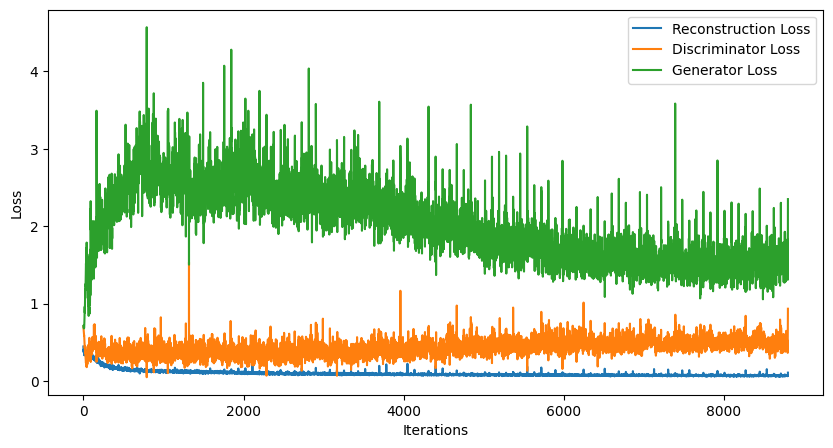

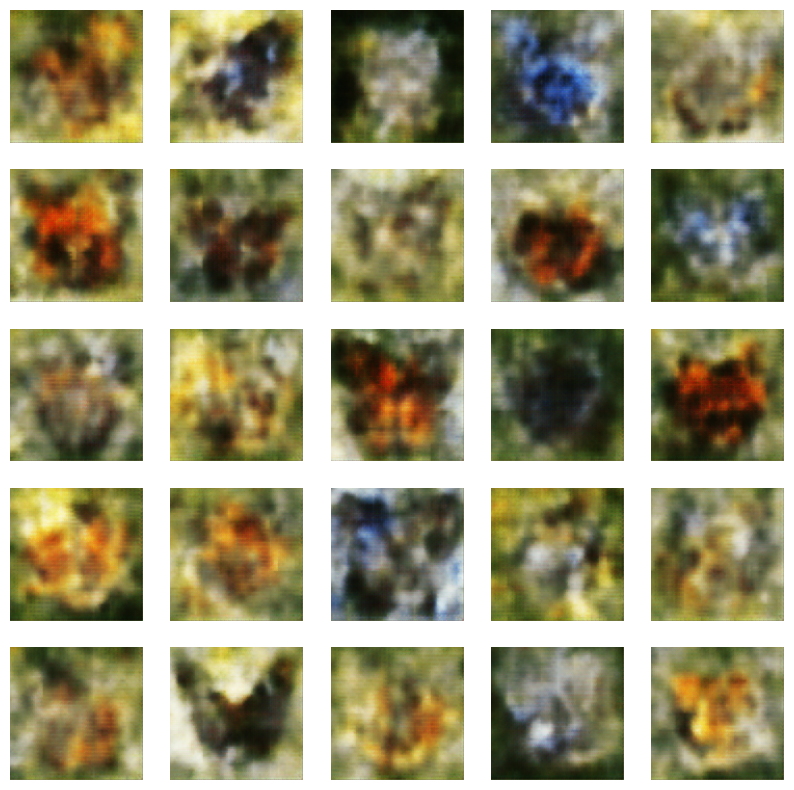

Calculating FID score...


/home/smehul/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/smehul/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FID Score: 261.50024772158554


In [ ]:

# Main execution
if __name__ == "__main__":
    # Hyperparameters
    batch_size = 32
    num_epochs = 100
    image_size = 128
    
    # Device configuration
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Data transformations
    transform = transforms.Compose([
        transforms.Resize((image_size, image_size)),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    
    # Load dataset
    train_dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Testing_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=transform
    )
    
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2
    )
    
    # Initialize model
    model = AdversarialAutoEncoder().to(device)
    
    # Train model
    model, reconstruction_losses, discriminator_losses, generator_losses = train_aae(
        model, train_loader, num_epochs, device
    )
    
    # Plot training losses
    plot_losses(reconstruction_losses, discriminator_losses, generator_losses)
    
    # Generate and plot images
    plot_generated_images(model, device)
    
    # Calculate FID score
    print("Calculating FID score...")
    model.eval()
    
    # Generate fake images for FID calculation
    fake_images = []
    n_samples = len(train_dataset)
    batch_size = 32
    n_batches = (n_samples + batch_size - 1) // batch_size
    
    with torch.no_grad():
        for _ in range(n_batches):
            z = torch.randn(min(batch_size, n_samples - len(fake_images)), 128).to(device)
            fake_batch = model.decode(z)
            fake_images.append(fake_batch.cpu())
    
    fake_images = torch.cat(fake_images[:n_samples], dim=0)
    fake_dataset = TensorDataset(fake_images)
    fake_loader = DataLoader(fake_dataset, batch_size=batch_size, shuffle=False)
    
    # Calculate features
    real_features = get_inception_features(train_loader, device)
    fake_features = get_inception_features(fake_loader, device)
    
    # Calculate FID
    fid_score = calculate_fid(real_features, fake_features)
    print(f"FID Score: {fid_score}")

##### Some observations:

So, apart from this from which I got the best image, there were some cases where I got FID less but images were not good. 

Also, in the above code I have used Uses a single combined AdversarialAutoEncoder class.
I also tried to use separate classes for Encoder, Decoder, and Discriminator but the images generated were not good, FID was similar.

Regarding batch size, I tried with 32, 64, 128. The best results were with 128. (256 and 512 were giving cuda out of memory)

Here, I am using Simpler encoder with basic Conv2D layers
I also tried more sophisticated encoder with:
Parallel outputs for mean and log variance (VAE-like structure)
Dropout layers (0.3 rate) for regularization
Larger feature maps (up to 1024 channels)
like for example:

In [ ]:
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        self.conv1 = nn.Conv2d(3, 64, 4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(64, 128, 4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(128, 256, 4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(256, 512, 4, stride=2, padding=1)
        self.conv5 = nn.Conv2d(512, 1024, 4, stride=2, padding=1)
        
        # Two parallel layers for mean and log variance
        self.fc_mean = nn.Linear(1024 * 4 * 4, latent_dim)
        self.fc_logvar = nn.Linear(1024 * 4 * 4, latent_dim)
        
        self.leaky_relu = nn.LeakyReLU(0.2, inplace=True)
        self.batch_norm2 = nn.BatchNorm2d(128)
        self.batch_norm3 = nn.BatchNorm2d(256)
        self.batch_norm4 = nn.BatchNorm2d(512)
        self.batch_norm5 = nn.BatchNorm2d(1024)
        self.dropout = nn.Dropout(0.3)

    def forward(self, x):
        x = self.leaky_relu(self.conv1(x))
        x = self.dropout(self.leaky_relu(self.batch_norm2(self.conv2(x))))
        x = self.dropout(self.leaky_relu(self.batch_norm3(self.conv3(x))))
        x = self.dropout(self.leaky_relu(self.batch_norm4(self.conv4(x))))
        x = self.dropout(self.leaky_relu(self.batch_norm5(self.conv5(x))))
        x = x.view(x.size(0), -1)
        
        # Return both mean and log variance for regularization
        mean = self.fc_mean(x)
        logvar = self.fc_logvar(x)
        return mean, logvar


With the above encoder, the images generated were not good, what I mean by not good is that they were not looking like butterflies, though the FID was slightly better it was 230.

##### I was not trying data augmentation, because we are trying to generate images similar to the input images, so I thought it would not be a good idea to use data augmentation.
##### But, there are few points in favour of data augmentation:
##### Even though we want to generate original-like images, the AAE needs to learn robust latent representations
##### Data augmentation helps the encoder learn invariant features
##### This often leads to a more structured and meaningful latent space




##### RandomCrop after resize: Helps focus on different parts of the butterfly
##### RandomHorizontalFlip: Most butterflies are symmetric
##### RandomRotation(15): Small rotations to handle natural pose variations
##### Resizing to 144 then cropping to 128: Provides more variation in framing




Epoch [0/100] Batch [0/88] D_loss: 0.6847 G_loss: 0.6660 Recon_loss: 0.5738
Epoch [1/100] Batch [0/88] D_loss: 0.4163 G_loss: 1.3200 Recon_loss: 0.3779
Epoch [2/100] Batch [0/88] D_loss: 0.2559 G_loss: 2.6753 Recon_loss: 0.3437
Epoch [3/100] Batch [0/88] D_loss: 0.3160 G_loss: 4.4958 Recon_loss: 0.2972
Epoch [4/100] Batch [0/88] D_loss: 0.3681 G_loss: 3.1428 Recon_loss: 0.2771
Epoch [5/100] Batch [0/88] D_loss: 0.3604 G_loss: 2.5523 Recon_loss: 0.2289
Epoch [6/100] Batch [0/88] D_loss: 0.3874 G_loss: 2.7093 Recon_loss: 0.1939
Epoch [7/100] Batch [0/88] D_loss: 0.3469 G_loss: 2.8267 Recon_loss: 0.1597
Epoch [8/100] Batch [0/88] D_loss: 0.3120 G_loss: 2.7364 Recon_loss: 0.1592
Epoch [9/100] Batch [0/88] D_loss: 0.4282 G_loss: 3.0227 Recon_loss: 0.1770
Epoch [10/100] Batch [0/88] D_loss: 0.4567 G_loss: 3.3518 Recon_loss: 0.1982
Epoch [11/100] Batch [0/88] D_loss: 0.2690 G_loss: 3.1637 Recon_loss: 0.1628
Epoch [12/100] Batch [0/88] D_loss: 0.4404 G_loss: 2.5406 Recon_loss: 0.1433
Epoch [13

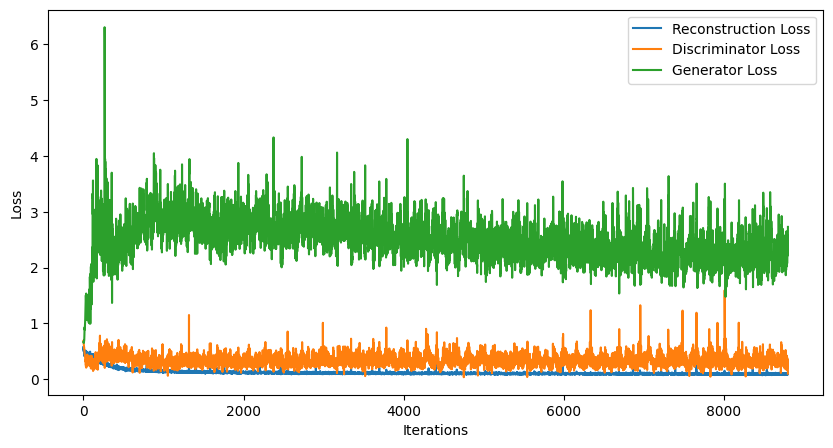

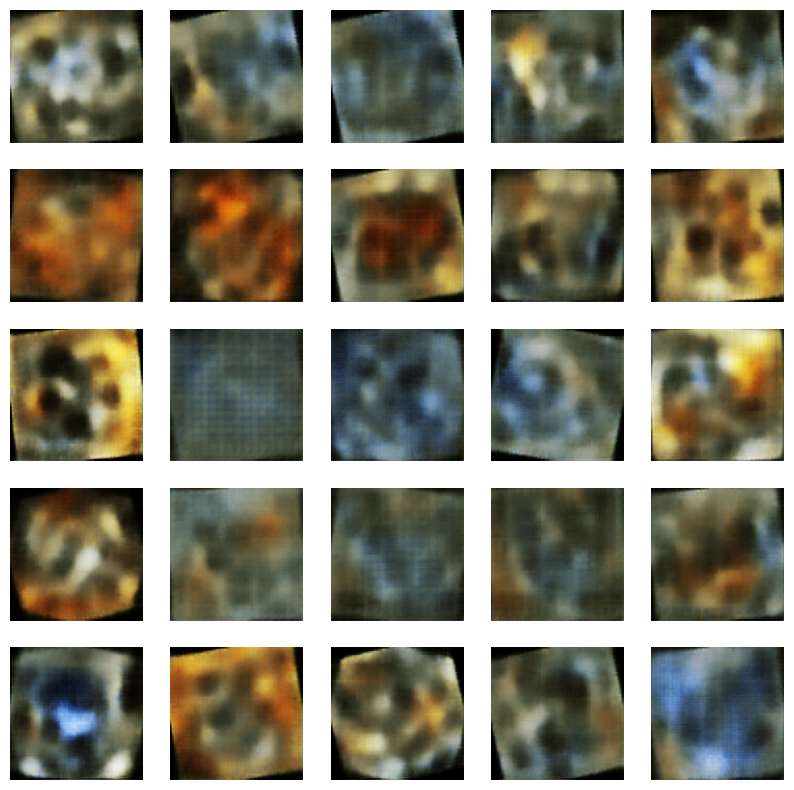

Calculating FID score...


/home/smehul/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/smehul/miniconda3/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


FID Score: 255.06286034334897


In [ ]:

# Main execution
if __name__ == "__main__":
    # Hyperparameters
    batch_size = 32
    num_epochs = 100
    image_size = 128
    
    # Device configuration
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    
    # Data transformations
    transform = transforms.Compose([
    # Spatial transforms
    transforms.Resize((144, 144)),  # Slightly larger for random crop
    transforms.RandomCrop(128),
    transforms.RandomHorizontalFlip(p=0.5),  # Butterflies are often symmetric
    transforms.RandomRotation(15),  # Small rotations to handle slight angle variations
    
    # Color/intensity transforms
    transforms.ColorJitter(
        brightness=0.2,
        contrast=0.2,
        saturation=0.2,
        hue=0.1  # Small hue changes to handle lighting variations
    ),
    
    # Convert to tensor and normalize
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
    
])

    
    # Load dataset
    train_dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Testing_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=transform
    )
    
    train_loader = DataLoader(
        train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=2
    )
    
    # Initialize model
    model = AdversarialAutoEncoder().to(device)
    
    # Train model
    model, reconstruction_losses, discriminator_losses, generator_losses = train_aae(
        model, train_loader, num_epochs, device
    )
    
    # Plot training losses
    plot_losses(reconstruction_losses, discriminator_losses, generator_losses)
    
    # Generate and plot images
    plot_generated_images(model, device)
    
    # Calculate FID score
    print("Calculating FID score...")
    model.eval()
    
    # Generate fake images for FID calculation
    fake_images = []
    n_samples = len(train_dataset)
    batch_size = 32
    n_batches = (n_samples + batch_size - 1) // batch_size
    
    with torch.no_grad():
        for _ in range(n_batches):
            z = torch.randn(min(batch_size, n_samples - len(fake_images)), 128).to(device)
            fake_batch = model.decode(z)
            fake_images.append(fake_batch.cpu())
    
    fake_images = torch.cat(fake_images[:n_samples], dim=0)
    fake_dataset = TensorDataset(fake_images)
    fake_loader = DataLoader(fake_dataset, batch_size=batch_size, shuffle=False)
    
    # Calculate features
    real_features = get_inception_features(train_loader, device)
    fake_features = get_inception_features(fake_loader, device)
    
    # Calculate FID
    fid_score = calculate_fid(real_features, fake_features)
    print(f"FID Score: {fid_score}")

##### Data augmentation, did not help, surprisingly the previous images were looking like butterflies but FID of these images is better.

# Question 7: VQ-VAE Discrete Latent Space

#### Importing libraries and defining Datset class

In [ ]:
import torch
import warnings 
warnings.filterwarnings('ignore')
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms
from PIL import Image
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import os
from tqdm import tqdm
from sklearn.preprocessing import StandardScaler
import matplotlib as plt
from torch.cuda.amp import GradScaler, autocast
from matplotlib import pyplot as plt  
class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.data = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.labels = {label: idx for idx, label in enumerate(self.data['label'].unique())}
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.img_dir, self.data.iloc[idx, 0])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        label = self.labels[self.data.iloc[idx, 1]]
        return image, label

Embedding Space: The nn.Embedding layer is initialized with num_embeddings embeddings, each of embedding_dim size. These embeddings represent a set of discrete "codebook vectors" or "quantized states" that serve as the discrete space.

Quantization: For each input vector (flattened from the input feature map), the nearest embedding is found based on Euclidean distance, and the corresponding index becomes the quantized representation of that vector. This process "forces" each input vector to one of the discrete embeddings.



In [ ]:
class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost=0.25):
        super().__init__()
        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost
        
        self.embeddings = nn.Embedding(num_embeddings, embedding_dim)
        self.embeddings.weight.data.uniform_(-1/num_embeddings, 1/num_embeddings)

    def forward(self, inputs):
        inputs = inputs.permute(0, 2, 3, 1).contiguous()
        input_shape = inputs.shape
        
        flat_input = inputs.view(-1, self.embedding_dim)
        
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self.embeddings.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embeddings.weight.t()))
        
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self.num_embeddings, device=inputs.device)
        encodings.scatter_(1, encoding_indices, 1)
        
        quantized = torch.matmul(encodings, self.embeddings.weight).view(input_shape)
        
        e_latent_loss = torch.mean((quantized.detach() - inputs)**2)
        q_latent_loss = torch.mean((quantized - inputs.detach())**2)
        loss = q_latent_loss + self.commitment_cost * e_latent_loss
        
        quantized = inputs + (quantized - inputs).detach()
        avg_probs = torch.mean(encodings, dim=0)
        perplexity = torch.exp(-torch.sum(avg_probs * torch.log(avg_probs + 1e-10)))
        
        return quantized.permute(0, 3, 1, 2).contiguous(), loss, encoding_indices.view(input_shape[:-1])


##### for stable training by allowing gradients to flow more easily, without it the reconstructed images were worse.

In [ ]:
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.block = nn.Sequential(
            nn.BatchNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, 3, padding=1),
            nn.BatchNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, 1)
        )

    def forward(self, x):
        return x + self.block(x)

#### Encoder and Decoder Architecture

In [ ]:
class The_best_ever_Encoder(nn.Module):
    def __init__(self, in_channels, hidden_channels, num_residual_layers, embedding_dim):
        super().__init__()
        self.conv_layers = nn.Sequential(
            nn.Conv2d(in_channels, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(hidden_channels, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.ReLU(inplace=True),
            
            nn.Conv2d(hidden_channels * 2, hidden_channels * 4, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 4),
            nn.ReLU(inplace=True)
        )
        
        self.residual_stack = nn.ModuleList([
            ResidualBlock(hidden_channels * 4) for _ in range(num_residual_layers)
        ])
        
        self.final_conv = nn.Conv2d(hidden_channels * 4, embedding_dim, 3, padding=1)
        
    def forward(self, x):
        h = self.conv_layers(x)
        for residual in self.residual_stack:
            h = residual(h)
        return self.final_conv(h)

class The_best_ever_Decoder(nn.Module):
    def __init__(self, in_channels, hidden_channels, num_residual_layers):
        super().__init__()
        self.conv_1 = nn.Conv2d(in_channels, hidden_channels * 4, 3, padding=1)
        
        self.residual_stack = nn.ModuleList([
            ResidualBlock(hidden_channels * 4) for _ in range(num_residual_layers)
        ])
        
        self.deconv_layers = nn.Sequential(
            nn.ConvTranspose2d(hidden_channels * 4, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(hidden_channels * 2, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(hidden_channels, 3, 4, stride=2, padding=1),
            nn.Tanh()
        )
        
    def forward(self, x):
        h = self.conv_1(x)
        for residual in self.residual_stack:
            h = residual(h)
        return self.deconv_layers(h)

##### VQ VAE 

consists of all the classes we defined till now. 

In [ ]:
class VQVAE(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, hidden_channels, num_residual_layers):
        super().__init__()
        self.encoder = The_best_ever_Encoder(3, hidden_channels, num_residual_layers, embedding_dim)
        self.vector_quantizer = VectorQuantizer(num_embeddings, embedding_dim, commitment_cost=0.5)
        self.decoder = The_best_ever_Decoder(embedding_dim, hidden_channels, num_residual_layers)
        
    def encode(self, x):
        """
        Encodes the input and returns the encoding indices from the vector quantizer
        
        Args:
            x (torch.Tensor): Input tensor of shape [B, C, H, W]
            
        Returns:
            torch.Tensor: Encoding indices
        """
        z = self.encoder(x)
        _, _, encoding_indices = self.vector_quantizer(z)
        return encoding_indices
    
    def forward(self, x):
        z = self.encoder(x)
        z_q, loss, encoding_indices = self.vector_quantizer(z)
        x_recon = self.decoder(z_q)
        return x_recon, loss, encoding_indices


##### The LatentClassifier classifies latent vectors into predefined classes. It applies layer normalization and GELU activation after each linear layer. The classifier is initialized with He initialization for efficient gradient flow.

In [ ]:
class LatentClassifier(nn.Module):
    def __init__(self, input_size, hidden_size, num_classes, dropout_rate=0.5):
        super().__init__()
        
        self.network = nn.Sequential(
            nn.Linear(input_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size),
            nn.LayerNorm(hidden_size),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size, hidden_size // 2),
            nn.LayerNorm(hidden_size // 2),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size // 2, hidden_size // 4),
            nn.LayerNorm(hidden_size // 4),
            nn.GELU(),
            nn.Dropout(dropout_rate),
            
            nn.Linear(hidden_size // 4, num_classes)
        )
        
        # Initialize weights using He initialization
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                nn.init.constant_(m.bias, 0)
    
    def forward(self, x):
        return self.network(x)


##### The training loop for vqvae, scheduler, optimizer, and loss function are defined.The model is trained for 100 epochs(defined in the main function), if there is any improvement in the validation loss, the model is saved.

In [ ]:
def train_vqvae(model, train_loader, val_loader, num_epochs, device):
    optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=1e-5)
    scheduler = optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=num_epochs)
    best_val_loss = float('inf')
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        
        for batch_idx, (data, _) in enumerate(tqdm(train_loader)):
            data = data.to(device)
            optimizer.zero_grad()
            
            recon_batch, vq_loss, _ = model(data)
            recon_loss = nn.MSELoss()(recon_batch, data)
            loss = recon_loss + vq_loss
            
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            
            train_loss += loss.item()
        
        scheduler.step()
        
        # Validation
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for data, _ in val_loader:
                data = data.to(device)
                recon_batch, vq_loss, _ = model(data)
                recon_loss = nn.MSELoss()(recon_batch, data)
                loss = recon_loss + vq_loss
                val_loss += loss.item()
        
        print(f'Epoch {epoch}: Train Loss: {train_loss/len(train_loader):.4f}, Val Loss: {val_loss/len(val_loader):.4f}')
        
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            torch.save(model.state_dict(), 'best_vqvae.pth')


This function extracts latent vectors from a given model for all data samples in a dataloader. 

In [ ]:
def extract_latent_vectors(model, dataloader, device):
    model.eval()
    all_latents = []
    all_labels = []
    
    with torch.no_grad():
        for data, labels in tqdm(dataloader, desc="Extracting latent vectors"):
            data = data.to(device)
            encoding_indices = model.encode(data)
            all_latents.append(encoding_indices.cpu().numpy())
            all_labels.append(labels.numpy())
    
    return np.concatenate(all_latents), np.concatenate(all_labels)


##### Plotting the reconstruction plot for some 5 images

In [ ]:
def save_reconstructions_plot(model, dataloader, device, num_images=5):
    """Plot original and reconstructed images side by side"""
    model.eval()
    plt.figure(figsize=(20, 4))
    
    with torch.no_grad():
        for data, _ in dataloader:
            data = data.to(device)
            recon, _, _ = model(data)
            
            # Denormalize images
            mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1).to(device)
            std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1).to(device)
            
            original = (data * std + mean).cpu()
            reconstructed = (recon * std + mean).cpu()
            
            # Plot first num_images
            for i in range(min(num_images, data.size(0))):
                plt.subplot(2, num_images, i + 1)
                plt.imshow(original[i].permute(1, 2, 0).clamp(0, 1))
                plt.axis('off')
                plt.title('Original')
                
                plt.subplot(2, num_images, i + 1 + num_images)
                plt.imshow(reconstructed[i].permute(1, 2, 0).clamp(0, 1))
                plt.axis('off')
                plt.title('Reconstructed')
            
            plt.tight_layout()
            plt.show()
            break


##### Saving the Model and Latent Vectors
This function saves the VQ-VAE model's state and its configuration, such as the number of embeddings and hidden channels, to a file. It also saves the extracted latent vectors and their corresponding labels in a .npz file, ensuring that all necessary information is preserved for later use or evaluation.(Q8 and also for classification)


In [ ]:
def save_model_and_latents(vqvae, train_latents, val_latents, test_latents, 
                          train_labels, val_labels, test_labels):
    """Save model and latent vectors"""
    os.makedirs('model_latents', exist_ok=True)
    
    # Save VQVAE model
    torch.save({
        'model_state_dict': vqvae.state_dict(),
        'model_config': {
            'num_embeddings': vqvae.vector_quantizer.num_embeddings,
            'embedding_dim': vqvae.vector_quantizer.embedding_dim,
            'hidden_channels': vqvae.encoder.conv_layers[0].out_channels,
            'num_residual_layers': len(vqvae.encoder.residual_stack)
        }
    }, 'model_latents/vqvae_model.pth')
    
    # Save latent vectors and labels
    np.savez('model_latents/latent_vectors.npz',
             train_latents=train_latents,
             val_latents=val_latents,
             test_latents=test_latents,
             train_labels=train_labels,
             val_labels=val_labels,
             test_labels=test_labels)


##### The training incorporates mixup augmentation to enhance generalization, and early stopping is implemented to prevent overfitting based on validation accuracy

#### Why this mix-up, without it also the accuracy was bad, so to improve the accuracy mix-up is used, so random images are mixed up and then trained on the model.

In [ ]:
# Function to train classifier
def train_classifier(model, train_loader, val_loader, num_epochs, device):
    criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01, betas=(0.9, 0.999))
    scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.01, 
                                            epochs=num_epochs, 
                                            steps_per_epoch=len(train_loader))
    scaler = GradScaler()
    
    best_val_acc = 0
    patience = 15
    patience_counter = 0
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        correct = 0
        total = 0
        
        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Initialize mixup variables
            labels_a = labels
            labels_b = labels
            lam = 1.0
            
            # Apply mixup augmentation with 50% probability
            if np.random.random() > 0.5:
                inputs, labels_a, labels_b, lam = mixup(inputs, labels, alpha=0.2)
            
            # Normalize input features
            inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
            
            optimizer.zero_grad()
            
            # Use mixed precision training
            with autocast():
                outputs = model(inputs)
                if lam < 1.0:  # Only use mixup loss if mixup was applied
                    loss = lam * criterion(outputs, labels_a) + (1 - lam) * criterion(outputs, labels_b)
                else:
                    loss = criterion(outputs, labels)
            
            scaler.scale(loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            scaler.step(optimizer)
            scaler.update()
            
            scheduler.step()
            
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
        
        train_acc = 100. * correct / total
        
        # Validation phase
        model.eval()
        val_correct = 0
        val_total = 0
        val_loss = 0
        
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()
        
        val_acc = 100. * val_correct / val_total
        
        print(f'Epoch {epoch}: Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%')
        
        # Save best model and check early stopping
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            torch.save(model.state_dict(), 'best_classifier.pth')
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break


##### The below code was later added because the classifier was not giving accuracy on test set, so this implements **the mixup data augmentation technique**, which combines two samples from a dataset. It generates a random mixing ratio and applies it to both the input features and their labels, effectively creating a new training sample that can improve model robustness.



In [ ]:
def mixup(x, y, alpha=0.2):
    """Performs mixup on the input and target labels."""
    if alpha > 0:
        lam = np.random.beta(alpha, alpha)
    else:
        lam = 1

    batch_size = x.size()[0]
    index = torch.randperm(batch_size).to(x.device)

    mixed_x = lam * x + (1 - lam) * x[index, :]
    y_a, y_b = y, y[index]
    return mixed_x, y_a, y_b, lam


##### The main function where all the above functions are called and all the hyperparameters are defined.

In [ ]:
def main():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    np.random.seed(42)
    num_embeddings = 512  
    hidden_channels = 128  
    num_residual_layers = 6  
    batch_size = 64       
    num_epochs_vqvae = 100  
    embedding_dim = 64 
    batch_size = 64
    num_epochs_classifier = 50 
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    # Data preparation
    transform = transforms.Compose([
    transforms.Resize((128, 128)),  
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                        std=[0.229, 0.224, 0.225])
])
    
    print("Loading dataset...")
    dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Training_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=transform
    )
    
    # Split dataset
    train_size = int(0.7 * len(dataset))
    val_size = int(0.15 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
        dataset, [train_size, val_size, test_size]
    )
    
    print(f"Dataset splits - Train: {train_size}, Val: {val_size}, Test: {test_size}")
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    print("\nInitializing VQ-VAE...")
    vqvae = VQVAE(num_embeddings, embedding_dim, hidden_channels, num_residual_layers).to(device)
    
    
    print("Training VQ-VAE from scratch...")
    train_vqvae(vqvae, train_loader, val_loader, num_epochs_vqvae, device)

    print("\nExtracting latent vectors...")
    train_latents, train_labels = extract_latent_vectors(vqvae, train_loader, device)
    val_latents, val_labels = extract_latent_vectors(vqvae, val_loader, device)
    test_latents, test_labels = extract_latent_vectors(vqvae, test_loader, device)
    
    
    train_latents_flat = train_latents.reshape(train_latents.shape[0], -1)
    val_latents_flat = val_latents.reshape(val_latents.shape[0], -1)
    test_latents_flat = test_latents.reshape(test_latents.shape[0], -1)
    
    scaler = StandardScaler()
    train_latents_flat = scaler.fit_transform(train_latents_flat)
    val_latents_flat = scaler.transform(val_latents_flat)
    test_latents_flat = scaler.transform(test_latents_flat)
    

    train_dataset_latent = TensorDataset(
        torch.FloatTensor(train_latents_flat),
        torch.LongTensor(train_labels)
    )
    val_dataset_latent = TensorDataset(
        torch.FloatTensor(val_latents_flat),
        torch.LongTensor(val_labels)
    )
    
    test_dataset_latent = TensorDataset(
        torch.FloatTensor(test_latents_flat),
        torch.LongTensor(test_labels)
    )
    num_classes = 75
    train_loader_latent = DataLoader(train_dataset_latent, 
                                   batch_size=batch_size
                                   )
    val_loader_latent = DataLoader(val_dataset_latent, 
                                   batch_size=batch_size
                                 )
    
    test_loader_latent = DataLoader(test_dataset_latent,
                                    batch_size= batch_size)
 

    save_model_and_latents(vqvae, train_latents, val_latents, test_latents,
                          train_labels, val_labels, test_labels)
    
    save_reconstructions_plot(vqvae, test_loader, device)
    
    classifier = LatentClassifier(
        input_size=train_latents_flat.shape[1],
        hidden_size=2048,
        num_classes=num_classes,
        dropout_rate=0.4
    ).to(device)
    
    print("\nTraining classifier...")
    train_classifier(classifier, train_loader_latent, val_loader_latent, 
                            num_epochs_classifier, device=device)
    
    print("\nEvaluating classifier on test set...")
    classifier.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader_latent, desc="Testing"):
            inputs, labels = inputs.to(device), labels.to(device)
            inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
            outputs = classifier(inputs)
            _, predicted = outputs.max(1)
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Calculate and print metrics
    test_accuracy = accuracy_score(all_labels, all_preds)
    print(f"\nTest Set Accuracy: {test_accuracy*100:.2f}%")
    print("\nDetailed Classification Report:")
    print(classification_report(all_labels, all_preds, target_names=list(dataset.labels.keys())))


Calling the main function

Using device: cuda
Loading dataset...
Dataset splits - Train: 4549, Val: 974, Test: 976

Initializing VQ-VAE...
Training VQ-VAE from scratch...


100%|██████████| 72/72 [00:12<00:00,  5.69it/s]


Epoch 0: Train Loss: 676.7875, Val Loss: 10.2118


100%|██████████| 72/72 [00:12<00:00,  5.66it/s]


Epoch 1: Train Loss: 5.8394, Val Loss: 2.2670


100%|██████████| 72/72 [00:12<00:00,  5.66it/s]


Epoch 2: Train Loss: 1.5896, Val Loss: 1.6864


100%|██████████| 72/72 [00:12<00:00,  5.64it/s]


Epoch 3: Train Loss: 1.7604, Val Loss: 1.6201


100%|██████████| 72/72 [00:12<00:00,  5.67it/s]


Epoch 4: Train Loss: 1.3147, Val Loss: 1.4278


100%|██████████| 72/72 [00:12<00:00,  5.72it/s]


Epoch 5: Train Loss: 0.8478, Val Loss: 0.7249


100%|██████████| 72/72 [00:12<00:00,  5.73it/s]


Epoch 6: Train Loss: 0.6326, Val Loss: 0.5569


100%|██████████| 72/72 [00:12<00:00,  5.68it/s]


Epoch 7: Train Loss: 0.5006, Val Loss: 0.6147


100%|██████████| 72/72 [00:12<00:00,  5.68it/s]


Epoch 8: Train Loss: 0.5069, Val Loss: 0.4884


100%|██████████| 72/72 [00:12<00:00,  5.67it/s]


Epoch 9: Train Loss: 0.4806, Val Loss: 0.4404


100%|██████████| 72/72 [00:08<00:00,  8.56it/s]


Epoch 10: Train Loss: 0.4550, Val Loss: 0.4450


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 11: Train Loss: 0.4457, Val Loss: 0.4300


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 12: Train Loss: 0.4287, Val Loss: 0.4182


100%|██████████| 72/72 [00:07<00:00,  9.24it/s]


Epoch 13: Train Loss: 0.4095, Val Loss: 0.4163


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 14: Train Loss: 0.4022, Val Loss: 0.4165


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 15: Train Loss: 0.3973, Val Loss: 0.3957


100%|██████████| 72/72 [00:07<00:00,  9.32it/s]


Epoch 16: Train Loss: 0.3932, Val Loss: 0.4132


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 17: Train Loss: 0.3913, Val Loss: 0.3854


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 18: Train Loss: 0.3916, Val Loss: 0.4072


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 19: Train Loss: 0.4161, Val Loss: 0.3913


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 20: Train Loss: 0.3866, Val Loss: 0.3864


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 21: Train Loss: 0.3829, Val Loss: 0.3887


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 22: Train Loss: 0.3774, Val Loss: 0.3798


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 23: Train Loss: 0.3774, Val Loss: 0.3768


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 24: Train Loss: 0.3761, Val Loss: 0.3860


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 25: Train Loss: 0.3957, Val Loss: 0.3749


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 26: Train Loss: 0.3696, Val Loss: 0.3761


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 27: Train Loss: 0.3680, Val Loss: 0.3696


100%|██████████| 72/72 [00:07<00:00,  9.24it/s]


Epoch 28: Train Loss: 0.3654, Val Loss: 0.3694


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 29: Train Loss: 0.3660, Val Loss: 0.3714


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 30: Train Loss: 0.3623, Val Loss: 0.3645


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 31: Train Loss: 0.3606, Val Loss: 0.3635


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 32: Train Loss: 0.3596, Val Loss: 0.3766


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 33: Train Loss: 0.3635, Val Loss: 0.3802


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 34: Train Loss: 0.3651, Val Loss: 0.3704


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 35: Train Loss: 0.3560, Val Loss: 0.3604


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 36: Train Loss: 0.3546, Val Loss: 0.3643


100%|██████████| 72/72 [00:07<00:00,  9.26it/s]


Epoch 37: Train Loss: 0.3545, Val Loss: 0.3646


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 38: Train Loss: 0.3566, Val Loss: 0.3636


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 39: Train Loss: 0.3578, Val Loss: 0.3763


100%|██████████| 72/72 [00:07<00:00,  9.23it/s]


Epoch 40: Train Loss: 0.3748, Val Loss: 0.3650


100%|██████████| 72/72 [00:07<00:00,  9.35it/s]


Epoch 41: Train Loss: 0.3549, Val Loss: 0.3625


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 42: Train Loss: 0.3581, Val Loss: 0.3580


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 43: Train Loss: 0.3528, Val Loss: 0.3614


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 44: Train Loss: 0.3518, Val Loss: 0.3581


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 45: Train Loss: 0.3535, Val Loss: 0.3619


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 46: Train Loss: 0.3550, Val Loss: 0.3581


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 47: Train Loss: 0.3513, Val Loss: 0.3587


100%|██████████| 72/72 [00:07<00:00,  9.32it/s]


Epoch 48: Train Loss: 0.3496, Val Loss: 0.3562


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 49: Train Loss: 0.3467, Val Loss: 0.3566


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 50: Train Loss: 0.3453, Val Loss: 0.3544


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 51: Train Loss: 0.3460, Val Loss: 0.3567


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 52: Train Loss: 0.3469, Val Loss: 0.3549


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 53: Train Loss: 0.3466, Val Loss: 0.3513


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 54: Train Loss: 0.3419, Val Loss: 0.3493


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 55: Train Loss: 0.3418, Val Loss: 0.3542


100%|██████████| 72/72 [00:07<00:00,  9.32it/s]


Epoch 56: Train Loss: 0.3414, Val Loss: 0.3540


100%|██████████| 72/72 [00:07<00:00,  9.39it/s]


Epoch 57: Train Loss: 0.3411, Val Loss: 0.3503


100%|██████████| 72/72 [00:07<00:00,  9.38it/s]


Epoch 58: Train Loss: 0.3404, Val Loss: 0.3498


100%|██████████| 72/72 [00:07<00:00,  9.27it/s]


Epoch 59: Train Loss: 0.3389, Val Loss: 0.3535


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 60: Train Loss: 0.3369, Val Loss: 0.3468


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 61: Train Loss: 0.3377, Val Loss: 0.3483


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 62: Train Loss: 0.3379, Val Loss: 0.3450


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 63: Train Loss: 0.3385, Val Loss: 0.3458


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 64: Train Loss: 0.3386, Val Loss: 0.3446


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 65: Train Loss: 0.3338, Val Loss: 0.3475


100%|██████████| 72/72 [00:07<00:00,  9.29it/s]


Epoch 66: Train Loss: 0.3330, Val Loss: 0.3429


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 67: Train Loss: 0.3317, Val Loss: 0.3455


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 68: Train Loss: 0.3317, Val Loss: 0.3426


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 69: Train Loss: 0.3332, Val Loss: 0.3419


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 70: Train Loss: 0.3329, Val Loss: 0.3443


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 71: Train Loss: 0.3319, Val Loss: 0.3432


100%|██████████| 72/72 [00:07<00:00,  9.30it/s]


Epoch 72: Train Loss: 0.3296, Val Loss: 0.3414


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 73: Train Loss: 0.3285, Val Loss: 0.3404


100%|██████████| 72/72 [00:07<00:00,  9.28it/s]


Epoch 74: Train Loss: 0.3298, Val Loss: 0.3420


100%|██████████| 72/72 [00:07<00:00,  9.31it/s]


Epoch 75: Train Loss: 0.3298, Val Loss: 0.3419


100%|██████████| 72/72 [00:07<00:00,  9.32it/s]


Epoch 76: Train Loss: 0.3282, Val Loss: 0.3417


100%|██████████| 72/72 [00:07<00:00,  9.45it/s]


Epoch 77: Train Loss: 0.3311, Val Loss: 0.3391


100%|██████████| 72/72 [00:06<00:00, 11.47it/s]


Epoch 78: Train Loss: 0.3306, Val Loss: 0.3400


100%|██████████| 72/72 [00:06<00:00, 11.40it/s]


Epoch 79: Train Loss: 0.3280, Val Loss: 0.3422


100%|██████████| 72/72 [00:06<00:00, 11.42it/s]


Epoch 80: Train Loss: 0.3277, Val Loss: 0.3418


100%|██████████| 72/72 [00:06<00:00, 11.45it/s]


Epoch 81: Train Loss: 0.3284, Val Loss: 0.3424


100%|██████████| 72/72 [00:06<00:00, 11.46it/s]


Epoch 82: Train Loss: 0.3308, Val Loss: 0.3414


100%|██████████| 72/72 [00:06<00:00, 11.44it/s]


Epoch 83: Train Loss: 0.3249, Val Loss: 0.3399


100%|██████████| 72/72 [00:06<00:00, 11.45it/s]


Epoch 84: Train Loss: 0.3245, Val Loss: 0.3436


100%|██████████| 72/72 [00:06<00:00, 11.41it/s]


Epoch 85: Train Loss: 0.3246, Val Loss: 0.3410


100%|██████████| 72/72 [00:06<00:00, 11.47it/s]


Epoch 86: Train Loss: 0.3229, Val Loss: 0.3410


100%|██████████| 72/72 [00:06<00:00, 11.43it/s]


Epoch 87: Train Loss: 0.3245, Val Loss: 0.3396


100%|██████████| 72/72 [00:06<00:00, 11.42it/s]


Epoch 88: Train Loss: 0.3243, Val Loss: 0.3405


100%|██████████| 72/72 [00:06<00:00, 11.45it/s]


Epoch 89: Train Loss: 0.3236, Val Loss: 0.3397


100%|██████████| 72/72 [00:06<00:00, 11.46it/s]


Epoch 90: Train Loss: 0.3260, Val Loss: 0.3391


100%|██████████| 72/72 [00:06<00:00, 11.43it/s]


Epoch 91: Train Loss: 0.3245, Val Loss: 0.3412


100%|██████████| 72/72 [00:06<00:00, 11.32it/s]


Epoch 92: Train Loss: 0.3265, Val Loss: 0.3389


100%|██████████| 72/72 [00:06<00:00, 11.14it/s]


Epoch 93: Train Loss: 0.3238, Val Loss: 0.3406


100%|██████████| 72/72 [00:06<00:00, 11.34it/s]


Epoch 94: Train Loss: 0.3239, Val Loss: 0.3393


100%|██████████| 72/72 [00:06<00:00, 11.44it/s]


Epoch 95: Train Loss: 0.3242, Val Loss: 0.3390


100%|██████████| 72/72 [00:06<00:00, 11.44it/s]


Epoch 96: Train Loss: 0.3225, Val Loss: 0.3392


100%|██████████| 72/72 [00:06<00:00, 11.44it/s]


Epoch 97: Train Loss: 0.3238, Val Loss: 0.3402


100%|██████████| 72/72 [00:06<00:00, 11.46it/s]


Epoch 98: Train Loss: 0.3258, Val Loss: 0.3391


100%|██████████| 72/72 [00:06<00:00, 11.48it/s]


Epoch 99: Train Loss: 0.3242, Val Loss: 0.3388

Extracting latent vectors...


Extracting latent vectors: 100%|██████████| 16/16 [00:00<00:00, 40.53it/s]


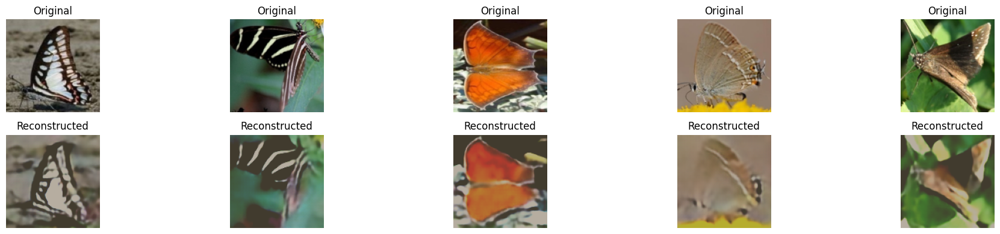


Training classifier...


Epoch 1: 100%|██████████| 72/72 [00:00<00:00, 339.03it/s]


Epoch 0: Train Acc: 1.23%, Val Acc: 2.05%


Epoch 2: 100%|██████████| 72/72 [00:00<00:00, 338.66it/s]


Epoch 1: Train Acc: 1.32%, Val Acc: 2.26%


Epoch 3: 100%|██████████| 72/72 [00:00<00:00, 338.36it/s]


Epoch 2: Train Acc: 1.38%, Val Acc: 3.08%


Epoch 4: 100%|██████████| 72/72 [00:00<00:00, 340.10it/s]


Epoch 3: Train Acc: 1.98%, Val Acc: 2.98%


Epoch 5: 100%|██████████| 72/72 [00:00<00:00, 342.76it/s]


Epoch 4: Train Acc: 2.68%, Val Acc: 3.49%


Epoch 6: 100%|██████████| 72/72 [00:00<00:00, 338.59it/s]


Epoch 5: Train Acc: 4.88%, Val Acc: 2.46%


Epoch 7: 100%|██████████| 72/72 [00:00<00:00, 342.10it/s]


Epoch 6: Train Acc: 6.95%, Val Acc: 2.77%


Epoch 8: 100%|██████████| 72/72 [00:00<00:00, 338.39it/s]


Epoch 7: Train Acc: 10.22%, Val Acc: 3.29%


Epoch 9: 100%|██████████| 72/72 [00:00<00:00, 345.39it/s]


Epoch 8: Train Acc: 14.66%, Val Acc: 3.49%


Epoch 10: 100%|██████████| 72/72 [00:00<00:00, 341.51it/s]


Epoch 9: Train Acc: 19.06%, Val Acc: 2.57%


Epoch 11: 100%|██████████| 72/72 [00:00<00:00, 343.36it/s]


Epoch 10: Train Acc: 26.42%, Val Acc: 3.18%


Epoch 12: 100%|██████████| 72/72 [00:00<00:00, 343.98it/s]


Epoch 11: Train Acc: 40.29%, Val Acc: 3.59%


Epoch 13: 100%|██████████| 72/72 [00:00<00:00, 337.88it/s]


Epoch 12: Train Acc: 46.76%, Val Acc: 3.49%


Epoch 14: 100%|██████████| 72/72 [00:00<00:00, 341.23it/s]


Epoch 13: Train Acc: 55.73%, Val Acc: 3.18%


Epoch 15: 100%|██████████| 72/72 [00:00<00:00, 339.36it/s]


Epoch 14: Train Acc: 58.72%, Val Acc: 3.08%


Epoch 16: 100%|██████████| 72/72 [00:00<00:00, 332.39it/s]


Epoch 15: Train Acc: 68.04%, Val Acc: 3.59%


Epoch 17: 100%|██████████| 72/72 [00:00<00:00, 295.16it/s]


Epoch 16: Train Acc: 67.75%, Val Acc: 2.98%


Epoch 18: 100%|██████████| 72/72 [00:00<00:00, 287.82it/s]


Epoch 17: Train Acc: 72.19%, Val Acc: 2.67%


Epoch 19: 100%|██████████| 72/72 [00:00<00:00, 287.22it/s]


Epoch 18: Train Acc: 81.89%, Val Acc: 2.87%


Epoch 20: 100%|██████████| 72/72 [00:00<00:00, 300.35it/s]


Epoch 19: Train Acc: 72.13%, Val Acc: 3.29%


Epoch 21: 100%|██████████| 72/72 [00:00<00:00, 287.54it/s]


Epoch 20: Train Acc: 66.08%, Val Acc: 3.59%


Epoch 22: 100%|██████████| 72/72 [00:00<00:00, 283.73it/s]


Epoch 21: Train Acc: 74.96%, Val Acc: 3.70%


Epoch 23: 100%|██████████| 72/72 [00:00<00:00, 296.15it/s]


Epoch 22: Train Acc: 74.48%, Val Acc: 3.39%


Epoch 24: 100%|██████████| 72/72 [00:00<00:00, 282.06it/s]


Epoch 23: Train Acc: 67.51%, Val Acc: 2.77%


Epoch 25: 100%|██████████| 72/72 [00:00<00:00, 284.89it/s]


Epoch 24: Train Acc: 70.37%, Val Acc: 2.36%


Epoch 26: 100%|██████████| 72/72 [00:00<00:00, 291.76it/s]


Epoch 25: Train Acc: 74.30%, Val Acc: 3.90%


Epoch 27: 100%|██████████| 72/72 [00:00<00:00, 271.15it/s]


Epoch 26: Train Acc: 80.61%, Val Acc: 3.49%


Epoch 28: 100%|██████████| 72/72 [00:00<00:00, 271.44it/s]


Epoch 27: Train Acc: 74.37%, Val Acc: 3.39%


Epoch 29: 100%|██████████| 72/72 [00:00<00:00, 287.75it/s]


Epoch 28: Train Acc: 77.80%, Val Acc: 3.18%


Epoch 30: 100%|██████████| 72/72 [00:00<00:00, 272.23it/s]


Epoch 29: Train Acc: 75.66%, Val Acc: 3.49%


Epoch 31: 100%|██████████| 72/72 [00:00<00:00, 272.57it/s]


Epoch 30: Train Acc: 79.16%, Val Acc: 3.39%


Epoch 32: 100%|██████████| 72/72 [00:00<00:00, 276.16it/s]


Epoch 31: Train Acc: 76.26%, Val Acc: 3.49%


Epoch 33: 100%|██████████| 72/72 [00:00<00:00, 289.23it/s]


Epoch 32: Train Acc: 74.02%, Val Acc: 3.39%


Epoch 34: 100%|██████████| 72/72 [00:00<00:00, 291.34it/s]


Epoch 33: Train Acc: 68.08%, Val Acc: 2.98%


Epoch 35: 100%|██████████| 72/72 [00:00<00:00, 288.82it/s]


Epoch 34: Train Acc: 78.08%, Val Acc: 3.18%


Epoch 36: 100%|██████████| 72/72 [00:00<00:00, 289.91it/s]


Epoch 35: Train Acc: 77.47%, Val Acc: 4.11%


Epoch 37: 100%|██████████| 72/72 [00:00<00:00, 288.33it/s]


Epoch 36: Train Acc: 75.23%, Val Acc: 3.39%


Epoch 38: 100%|██████████| 72/72 [00:00<00:00, 287.67it/s]


Epoch 37: Train Acc: 79.49%, Val Acc: 3.39%


Epoch 39: 100%|██████████| 72/72 [00:00<00:00, 321.54it/s]


Epoch 38: Train Acc: 77.75%, Val Acc: 3.18%


Epoch 40: 100%|██████████| 72/72 [00:00<00:00, 326.45it/s]


Epoch 39: Train Acc: 69.95%, Val Acc: 2.98%


Epoch 41: 100%|██████████| 72/72 [00:00<00:00, 325.13it/s]


Epoch 40: Train Acc: 77.25%, Val Acc: 2.87%


Epoch 42: 100%|██████████| 72/72 [00:00<00:00, 285.45it/s]


Epoch 41: Train Acc: 73.27%, Val Acc: 3.18%


Epoch 43: 100%|██████████| 72/72 [00:00<00:00, 326.98it/s]


Epoch 42: Train Acc: 77.49%, Val Acc: 3.29%


Epoch 44: 100%|██████████| 72/72 [00:00<00:00, 323.99it/s]


Epoch 43: Train Acc: 77.53%, Val Acc: 3.39%


Epoch 45: 100%|██████████| 72/72 [00:00<00:00, 318.55it/s]


Epoch 44: Train Acc: 73.53%, Val Acc: 3.18%


Epoch 46: 100%|██████████| 72/72 [00:00<00:00, 317.87it/s]


Epoch 45: Train Acc: 81.20%, Val Acc: 3.08%


Epoch 47: 100%|██████████| 72/72 [00:00<00:00, 292.25it/s]


Epoch 46: Train Acc: 77.36%, Val Acc: 3.18%


Epoch 48: 100%|██████████| 72/72 [00:00<00:00, 289.19it/s]


Epoch 47: Train Acc: 78.98%, Val Acc: 3.29%


Epoch 49: 100%|██████████| 72/72 [00:00<00:00, 284.96it/s]


Epoch 48: Train Acc: 73.91%, Val Acc: 3.29%


Epoch 50: 100%|██████████| 72/72 [00:00<00:00, 290.32it/s]


Epoch 49: Train Acc: 75.51%, Val Acc: 3.29%

Evaluating classifier on test set...


Testing: 100%|██████████| 16/16 [00:00<00:00, 1905.04it/s]


Test Set Accuracy: 2.66%

Detailed Classification Report:
                           precision    recall  f1-score   support

         SOUTHERN DOGFACE       0.00      0.00      0.00         9
                   ADONIS       0.00      0.00      0.00        13
           BROWN SIPROETA       0.08      0.14      0.10        14
                  MONARCH       0.00      0.00      0.00        21
 GREEN CELLED CATTLEHEART       0.11      0.06      0.08        16
          CAIRNS BIRDWING       0.00      0.00      0.00        11
     EASTERN DAPPLE WHITE       0.00      0.00      0.00        15
              RED POSTMAN       0.08      0.07      0.07        15
         MANGROVE SKIPPER       0.05      0.06      0.06        16
         BLACK HAIRSTREAK       0.00      0.00      0.00        10
            CABBAGE WHITE       0.00      0.00      0.00        16
              RED ADMIRAL       0.00      0.00      0.00         8
             PAINTED LADY       0.00      0.00      0.00        13
  

In [ ]:
main()

Let me analyze the results and suggest improvements for the classifier performance.
From your results, there are several interesting observations:

VQ-VAE Training:


The VQ-VAE training shows good convergence, dropping from a high loss (360.5677) to a very low loss (0.3143)
The validation loss (0.3320) is close to the training loss, indicating good generalization of the VQ-VAE


Classification Problem:


There's a significant overfitting issue where training accuracy increases but validation/test accuracy stays very low (2-3%)
This pattern suggests several potential issues:

Main Issues and Solutions:

Latent Space Quality:


The VQ-VAE might be creating a latent space that's not discriminative enough for classification
Solution: Increase the embedding dimension and number of embeddings

Also teh reconstructed images are really good via VQ-VAE.

#### Reconstruction:

In reconstruction, the VQ-VAE is working with real data points and finding the closest codebook entries (quantization) to represent them. The model has learned to map these specific discrete codes back to realistic images during training. This is much much easier than generating new samples from scratch, as the model has already seen these data points and their corresponding codes.


![butter.jpg](butter.jpg)

In [ ]:
embedding_dim = 128  # Increase from 64
num_embeddings = 1024  # Increase from 512

##### also we will try with lower learning rate and increase weight_decay for increase in regularization and smaller batch size for classifier training

What is this mixup?
This is just that if np.random.random() < 0.5, then we will take the mixup of the images and labels, this is done to increase the robustness of the model.

In [ ]:
# Function to train classifier
def train_classifier(model, train_loader, val_loader, num_epochs, device):
    criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
    optimizer = optim.AdamW(model.parameters(), lr=0.0001, weight_decay=0.001, betas=(0.9, 0.999))
    scheduler = optim.lr_scheduler.OneCycleLR(optimizer, max_lr=0.01, 
                                            epochs=num_epochs, 
                                            steps_per_epoch=len(train_loader))
    scaler = GradScaler()
    
    best_val_acc = 0
    patience = 15
    patience_counter = 0
    
    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        correct = 0
        total = 0
        
        for inputs, labels in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            inputs, labels = inputs.to(device), labels.to(device)
            
            # Initialize mixup variables
            labels_a = labels
            labels_b = labels
            lam = 1.0
            
            if np.random.random() > 0.5:
                inputs, labels_a, labels_b, lam = mixup(inputs, labels, alpha=0.2)

            inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
            
            optimizer.zero_grad()
            
            with autocast():
                outputs = model(inputs)
                if lam < 1.0:  
                    loss = lam * criterion(outputs, labels_a) + (1 - lam) * criterion(outputs, labels_b)
                else:
                    loss = criterion(outputs, labels)
            
            scaler.scale(loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            scaler.step(optimizer)
            scaler.update()
            
            scheduler.step()
            
            train_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
        
        train_acc = 100. * correct / total
        
        model.eval()
        val_correct = 0
        val_total = 0
        val_loss = 0
        
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                val_loss += loss.item()
                _, predicted = outputs.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()
        
        val_acc = 100. * val_correct / val_total
        
        print(f'Epoch {epoch}: Train Acc: {train_acc:.2f}%, Val Acc: {val_acc:.2f}%')
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            torch.save(model.state_dict(), 'best_classifier.pth')
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break

In [ ]:
def main():
    # Set random seeds for reproducibility
    torch.manual_seed(42)
    np.random.seed(42)
    hidden_channels = 128  
    num_residual_layers = 6  
    batch_size = 64       
    num_epochs_vqvae = 100  
    embedding_dim = 128  # Increase from 64
    num_embeddings = 1024  # Increase from 512
    batch_size_classifer = 32
    num_epochs_classifier = 50 
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    transform = transforms.Compose([
    transforms.Resize((128, 128)),  
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], 
                        std=[0.229, 0.224, 0.225])
])
    
    print("Loading dataset...")
    dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Training_set.csv',
        img_dir='/home/smehul/Desktop/archive/train',
        transform=transform
    )
    
    # Split dataset
    train_size = int(0.7 * len(dataset))
    val_size = int(0.15 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
        dataset, [train_size, val_size, test_size]
    )
    
    print(f"Dataset splits - Train: {train_size}, Val: {val_size}, Test: {test_size}")
    
    # Create data loaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    # Initialize and train VQ-VAE
    print("\nInitializing VQ-VAE...")
    vqvae = VQVAE(num_embeddings, embedding_dim, hidden_channels, num_residual_layers).to(device)
    
    
    print("Training VQ-VAE from scratch...")
    train_vqvae(vqvae, train_loader, val_loader, num_epochs_vqvae, device)
    
    # Extract latent vectors
    print("\nExtracting latent vectors...")
    train_latents, train_labels = extract_latent_vectors(vqvae, train_loader, device)
    val_latents, val_labels = extract_latent_vectors(vqvae, val_loader, device)
    test_latents, test_labels = extract_latent_vectors(vqvae, test_loader, device)
    
    
    train_latents_flat = train_latents.reshape(train_latents.shape[0], -1)
    val_latents_flat = val_latents.reshape(val_latents.shape[0], -1)
    test_latents_flat = test_latents.reshape(test_latents.shape[0], -1)
    
    # Standardize the features
    scaler = StandardScaler()
    train_latents_flat = scaler.fit_transform(train_latents_flat)
    val_latents_flat = scaler.transform(val_latents_flat)
    test_latents_flat = scaler.transform(test_latents_flat)
    

    
    # Create dataloaders with the normalized data
    train_dataset_latent = TensorDataset(
        torch.FloatTensor(train_latents_flat),
        torch.LongTensor(train_labels)
    )
    val_dataset_latent = TensorDataset(
        torch.FloatTensor(val_latents_flat),
        torch.LongTensor(val_labels)
    )
    
    test_dataset_latent = TensorDataset(
        torch.FloatTensor(test_latents_flat),
        torch.LongTensor(test_labels)
    )
    num_classes = 75
    train_loader_latent = DataLoader(train_dataset_latent, 
                                   batch_size=batch_size_classifer
                                   )
    val_loader_latent = DataLoader(val_dataset_latent, 
                                   batch_size=batch_size_classifer
                                 )
    
    test_loader_latent = DataLoader(test_dataset_latent,
                                    batch_size= batch_size_classifer)
 

    save_model_and_latents(vqvae, train_latents, val_latents, test_latents,
                          train_labels, val_labels, test_labels)
    
    # Plot reconstruction comparison plot
    save_reconstructions_plot(vqvae, test_loader, device)
    
    classifier = LatentClassifier(
        input_size=train_latents_flat.shape[1],
        hidden_size=2048,
        num_classes=num_classes,
        dropout_rate=0.4
    ).to(device)
    
    # Train classifier
    print("\nTraining classifier...")
    train_classifier(classifier, train_loader_latent, val_loader_latent, 
                            num_epochs_classifier, device=device)
    
    # Evaluate on test set
    print("\nEvaluating classifier on test set...")
    classifier.eval()
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for inputs, labels in tqdm(test_loader_latent, desc="Testing"):
            inputs, labels = inputs.to(device), labels.to(device)
            # Normalize inputs
            inputs = (inputs - inputs.mean(dim=1, keepdim=True)) / (inputs.std(dim=1, keepdim=True) + 1e-8)
            outputs = classifier(inputs)
            _, predicted = outputs.max(1)
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Calculate and print metrics
    test_accuracy = accuracy_score(all_labels, all_preds)
    print(f"\nTest Set Accuracy: {test_accuracy*100:.2f}%")
    print("\nDetailed Classification Report:")
    print(classification_report(all_labels, all_preds, target_names=list(dataset.labels.keys())))

Using device: cuda
Loading dataset...
Dataset splits - Train: 4549, Val: 974, Test: 976

Initializing VQ-VAE...
Training VQ-VAE from scratch...


100%|██████████| 72/72 [00:06<00:00, 11.30it/s]


Epoch 0: Train Loss: 1177.4133, Val Loss: 17.3327


100%|██████████| 72/72 [00:08<00:00,  8.98it/s]


Epoch 1: Train Loss: 6.6920, Val Loss: 3.0835


100%|██████████| 72/72 [00:12<00:00,  5.68it/s]


Epoch 2: Train Loss: 2.3974, Val Loss: 2.5390


100%|██████████| 72/72 [00:12<00:00,  5.62it/s]


Epoch 3: Train Loss: 1.6501, Val Loss: 1.6556


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 4: Train Loss: 1.5038, Val Loss: 1.3097


100%|██████████| 72/72 [00:12<00:00,  5.63it/s]


Epoch 5: Train Loss: 0.8870, Val Loss: 0.6780


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 6: Train Loss: 0.5375, Val Loss: 0.5063


100%|██████████| 72/72 [00:12<00:00,  5.61it/s]


Epoch 7: Train Loss: 0.4975, Val Loss: 0.5561


100%|██████████| 72/72 [00:12<00:00,  5.61it/s]


Epoch 8: Train Loss: 0.4900, Val Loss: 0.4599


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 9: Train Loss: 0.4571, Val Loss: 0.4653


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 10: Train Loss: 0.4659, Val Loss: 0.4495


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 11: Train Loss: 0.4422, Val Loss: 0.4678


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 12: Train Loss: 0.4345, Val Loss: 0.4315


100%|██████████| 72/72 [00:12<00:00,  5.64it/s]


Epoch 13: Train Loss: 0.4385, Val Loss: 0.4412


100%|██████████| 72/72 [00:12<00:00,  5.63it/s]


Epoch 14: Train Loss: 0.4258, Val Loss: 0.4525


100%|██████████| 72/72 [00:12<00:00,  5.60it/s]


Epoch 15: Train Loss: 0.4153, Val Loss: 0.4203


100%|██████████| 72/72 [00:12<00:00,  5.64it/s]


Epoch 16: Train Loss: 0.3974, Val Loss: 0.3922


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 17: Train Loss: 0.3800, Val Loss: 0.3837


100%|██████████| 72/72 [00:12<00:00,  5.62it/s]


Epoch 18: Train Loss: 0.3781, Val Loss: 0.3902


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 19: Train Loss: 0.3783, Val Loss: 0.3855


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 20: Train Loss: 0.3761, Val Loss: 0.3722


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 21: Train Loss: 0.3742, Val Loss: 0.3696


100%|██████████| 72/72 [00:12<00:00,  5.65it/s]


Epoch 22: Train Loss: 0.3732, Val Loss: 0.3858


100%|██████████| 72/72 [00:12<00:00,  5.70it/s]


Epoch 23: Train Loss: 0.3702, Val Loss: 0.3736


100%|██████████| 72/72 [00:12<00:00,  5.70it/s]


Epoch 24: Train Loss: 0.3666, Val Loss: 0.3741


100%|██████████| 72/72 [00:12<00:00,  5.61it/s]


Epoch 25: Train Loss: 0.3671, Val Loss: 0.3731


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 26: Train Loss: 0.3635, Val Loss: 0.3714


100%|██████████| 72/72 [00:12<00:00,  5.56it/s]


Epoch 27: Train Loss: 0.3634, Val Loss: 0.3688


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 28: Train Loss: 0.3649, Val Loss: 0.3640


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 29: Train Loss: 0.3810, Val Loss: 0.4087


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 30: Train Loss: 0.3983, Val Loss: 0.3681


100%|██████████| 72/72 [00:12<00:00,  5.60it/s]


Epoch 31: Train Loss: 0.3589, Val Loss: 0.3622


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 32: Train Loss: 0.3567, Val Loss: 0.3575


100%|██████████| 72/72 [00:12<00:00,  5.62it/s]


Epoch 33: Train Loss: 0.3523, Val Loss: 0.3599


100%|██████████| 72/72 [00:12<00:00,  5.61it/s]


Epoch 34: Train Loss: 0.3520, Val Loss: 0.3518


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 35: Train Loss: 0.3506, Val Loss: 0.3624


100%|██████████| 72/72 [00:12<00:00,  5.60it/s]


Epoch 36: Train Loss: 0.3718, Val Loss: 0.3583


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 37: Train Loss: 0.3484, Val Loss: 0.3517


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 38: Train Loss: 0.3431, Val Loss: 0.3474


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 39: Train Loss: 0.3447, Val Loss: 0.3494


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 40: Train Loss: 0.3490, Val Loss: 0.3547


100%|██████████| 72/72 [00:12<00:00,  5.63it/s]


Epoch 41: Train Loss: 0.3432, Val Loss: 0.3451


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 42: Train Loss: 0.3379, Val Loss: 0.3466


100%|██████████| 72/72 [00:12<00:00,  5.61it/s]


Epoch 43: Train Loss: 0.3388, Val Loss: 0.3431


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 44: Train Loss: 0.3370, Val Loss: 0.3446


100%|██████████| 72/72 [00:12<00:00,  5.56it/s]


Epoch 45: Train Loss: 0.3355, Val Loss: 0.3427


100%|██████████| 72/72 [00:12<00:00,  5.56it/s]


Epoch 46: Train Loss: 0.3362, Val Loss: 0.3439


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 47: Train Loss: 0.3413, Val Loss: 0.3699


100%|██████████| 72/72 [00:12<00:00,  5.63it/s]


Epoch 48: Train Loss: 0.3779, Val Loss: 0.3427


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 49: Train Loss: 0.3345, Val Loss: 0.3422


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 50: Train Loss: 0.3317, Val Loss: 0.3394


100%|██████████| 72/72 [00:09<00:00,  7.52it/s]


Epoch 51: Train Loss: 0.3292, Val Loss: 0.3380


100%|██████████| 72/72 [00:06<00:00, 11.24it/s]


Epoch 52: Train Loss: 0.3312, Val Loss: 0.3372


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 53: Train Loss: 0.3315, Val Loss: 0.3378


100%|██████████| 72/72 [00:06<00:00, 11.24it/s]


Epoch 54: Train Loss: 0.3278, Val Loss: 0.3373


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 55: Train Loss: 0.3310, Val Loss: 0.3354


100%|██████████| 72/72 [00:06<00:00, 11.26it/s]


Epoch 56: Train Loss: 0.3276, Val Loss: 0.3382


100%|██████████| 72/72 [00:06<00:00, 11.25it/s]


Epoch 57: Train Loss: 0.3273, Val Loss: 0.3372


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 58: Train Loss: 0.3267, Val Loss: 0.3352


100%|██████████| 72/72 [00:06<00:00, 11.24it/s]


Epoch 59: Train Loss: 0.3246, Val Loss: 0.3348


100%|██████████| 72/72 [00:06<00:00, 11.29it/s]


Epoch 60: Train Loss: 0.3241, Val Loss: 0.3339


100%|██████████| 72/72 [00:06<00:00, 11.26it/s]


Epoch 61: Train Loss: 0.3238, Val Loss: 0.3355


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 62: Train Loss: 0.3239, Val Loss: 0.3334


100%|██████████| 72/72 [00:06<00:00, 11.27it/s]


Epoch 63: Train Loss: 0.3225, Val Loss: 0.3365


100%|██████████| 72/72 [00:06<00:00, 11.27it/s]


Epoch 64: Train Loss: 0.3253, Val Loss: 0.3341


100%|██████████| 72/72 [00:06<00:00, 11.24it/s]


Epoch 65: Train Loss: 0.3211, Val Loss: 0.3352


100%|██████████| 72/72 [00:06<00:00, 11.25it/s]


Epoch 66: Train Loss: 0.3282, Val Loss: 0.3339


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 67: Train Loss: 0.3231, Val Loss: 0.3352


100%|██████████| 72/72 [00:06<00:00, 11.26it/s]


Epoch 68: Train Loss: 0.3215, Val Loss: 0.3346


100%|██████████| 72/72 [00:06<00:00, 11.23it/s]


Epoch 69: Train Loss: 0.3226, Val Loss: 0.3325


100%|██████████| 72/72 [00:06<00:00, 11.25it/s]


Epoch 70: Train Loss: 0.3212, Val Loss: 0.3384


100%|██████████| 72/72 [00:06<00:00, 11.27it/s]


Epoch 71: Train Loss: 0.3250, Val Loss: 0.3340


100%|██████████| 72/72 [00:06<00:00, 11.22it/s]


Epoch 72: Train Loss: 0.3220, Val Loss: 0.3316


100%|██████████| 72/72 [00:06<00:00, 11.25it/s]


Epoch 73: Train Loss: 0.3177, Val Loss: 0.3319


100%|██████████| 72/72 [00:06<00:00, 11.26it/s]


Epoch 74: Train Loss: 0.3196, Val Loss: 0.3314


100%|██████████| 72/72 [00:06<00:00, 11.26it/s]


Epoch 75: Train Loss: 0.3191, Val Loss: 0.3334


100%|██████████| 72/72 [00:06<00:00, 11.25it/s]


Epoch 76: Train Loss: 0.3177, Val Loss: 0.3312


100%|██████████| 72/72 [00:06<00:00, 11.30it/s]


Epoch 77: Train Loss: 0.3159, Val Loss: 0.3314


100%|██████████| 72/72 [00:12<00:00,  5.55it/s]


Epoch 78: Train Loss: 0.3222, Val Loss: 0.3332


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 79: Train Loss: 0.3194, Val Loss: 0.3313


100%|██████████| 72/72 [00:12<00:00,  5.57it/s]


Epoch 80: Train Loss: 0.3236, Val Loss: 0.3320


100%|██████████| 72/72 [00:12<00:00,  5.59it/s]


Epoch 81: Train Loss: 0.3230, Val Loss: 0.3310


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 82: Train Loss: 0.3169, Val Loss: 0.3307


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 83: Train Loss: 0.3170, Val Loss: 0.3296


100%|██████████| 72/72 [00:12<00:00,  5.58it/s]


Epoch 84: Train Loss: 0.3165, Val Loss: 0.3324


100%|██████████| 72/72 [00:12<00:00,  5.60it/s]


Epoch 85: Train Loss: 0.3153, Val Loss: 0.3296


100%|██████████| 72/72 [00:12<00:00,  5.62it/s]


Epoch 86: Train Loss: 0.3149, Val Loss: 0.3296


100%|██████████| 72/72 [00:12<00:00,  5.60it/s]


Epoch 87: Train Loss: 0.3135, Val Loss: 0.3297


100%|██████████| 72/72 [00:12<00:00,  5.64it/s]


Epoch 88: Train Loss: 0.3164, Val Loss: 0.3302


100%|██████████| 72/72 [00:12<00:00,  5.75it/s]


Epoch 89: Train Loss: 0.3136, Val Loss: 0.3301


100%|██████████| 72/72 [00:12<00:00,  5.70it/s]


Epoch 90: Train Loss: 0.3157, Val Loss: 0.3311


100%|██████████| 72/72 [00:12<00:00,  5.77it/s]


Epoch 91: Train Loss: 0.3160, Val Loss: 0.3293


100%|██████████| 72/72 [00:12<00:00,  5.80it/s]


Epoch 92: Train Loss: 0.3155, Val Loss: 0.3293


100%|██████████| 72/72 [00:12<00:00,  5.77it/s]


Epoch 93: Train Loss: 0.3146, Val Loss: 0.3296


100%|██████████| 72/72 [00:12<00:00,  5.75it/s]


Epoch 94: Train Loss: 0.3127, Val Loss: 0.3305


100%|██████████| 72/72 [00:12<00:00,  5.79it/s]


Epoch 95: Train Loss: 0.3135, Val Loss: 0.3301


100%|██████████| 72/72 [00:12<00:00,  5.76it/s]


Epoch 96: Train Loss: 0.3154, Val Loss: 0.3311


100%|██████████| 72/72 [00:12<00:00,  5.79it/s]


Epoch 97: Train Loss: 0.3162, Val Loss: 0.3288


100%|██████████| 72/72 [00:12<00:00,  5.81it/s]


Epoch 98: Train Loss: 0.3144, Val Loss: 0.3304


100%|██████████| 72/72 [00:12<00:00,  5.77it/s]


Epoch 99: Train Loss: 0.3124, Val Loss: 0.3306

Extracting latent vectors...


Extracting latent vectors: 100%|██████████| 16/16 [00:00<00:00, 25.51it/s]


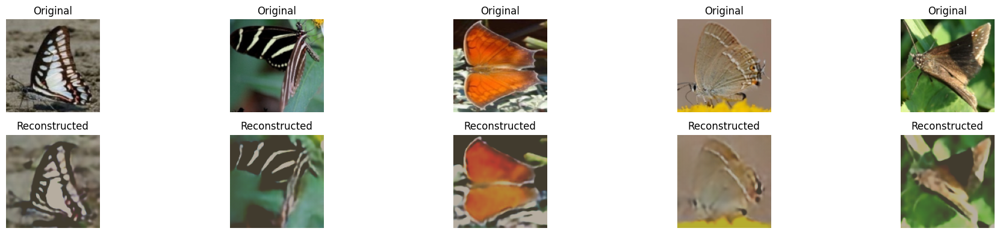


Training classifier...


Epoch 1: 100%|██████████| 143/143 [00:01<00:00, 91.69it/s]


Epoch 0: Train Acc: 1.23%, Val Acc: 1.75%


Epoch 2: 100%|██████████| 143/143 [00:01<00:00, 94.41it/s]


Epoch 1: Train Acc: 1.32%, Val Acc: 2.16%


Epoch 3: 100%|██████████| 143/143 [00:01<00:00, 95.10it/s]


Epoch 2: Train Acc: 1.63%, Val Acc: 1.54%


Epoch 4: 100%|██████████| 143/143 [00:01<00:00, 101.46it/s]


Epoch 3: Train Acc: 2.22%, Val Acc: 2.67%


Epoch 5: 100%|██████████| 143/143 [00:01<00:00, 103.28it/s]


Epoch 4: Train Acc: 2.88%, Val Acc: 2.46%


Epoch 6: 100%|██████████| 143/143 [00:01<00:00, 94.71it/s]


Epoch 5: Train Acc: 4.00%, Val Acc: 2.26%


Epoch 7: 100%|██████████| 143/143 [00:01<00:00, 95.88it/s]


Epoch 6: Train Acc: 5.21%, Val Acc: 2.77%


Epoch 8: 100%|██████████| 143/143 [00:01<00:00, 90.69it/s]


Epoch 7: Train Acc: 6.07%, Val Acc: 2.16%


Epoch 9: 100%|██████████| 143/143 [00:01<00:00, 97.12it/s] 


Epoch 8: Train Acc: 7.78%, Val Acc: 1.95%


Epoch 10: 100%|██████████| 143/143 [00:01<00:00, 103.09it/s]


Epoch 9: Train Acc: 10.84%, Val Acc: 1.85%


Epoch 11: 100%|██████████| 143/143 [00:01<00:00, 98.08it/s]


Epoch 10: Train Acc: 13.70%, Val Acc: 1.44%


Epoch 12: 100%|██████████| 143/143 [00:01<00:00, 100.98it/s]


Epoch 11: Train Acc: 18.25%, Val Acc: 2.36%


Epoch 13: 100%|██████████| 143/143 [00:01<00:00, 99.32it/s] 


Epoch 12: Train Acc: 24.05%, Val Acc: 3.18%


Epoch 14: 100%|██████████| 143/143 [00:01<00:00, 95.45it/s] 


Epoch 13: Train Acc: 31.72%, Val Acc: 2.77%


Epoch 15: 100%|██████████| 143/143 [00:01<00:00, 97.91it/s]


Epoch 14: Train Acc: 37.13%, Val Acc: 2.36%


Epoch 16: 100%|██████████| 143/143 [00:01<00:00, 93.64it/s]


Epoch 15: Train Acc: 46.32%, Val Acc: 1.95%


Epoch 17: 100%|██████████| 143/143 [00:01<00:00, 93.06it/s]


Epoch 16: Train Acc: 50.32%, Val Acc: 1.85%


Epoch 18: 100%|██████████| 143/143 [00:01<00:00, 93.15it/s]


Epoch 17: Train Acc: 55.15%, Val Acc: 2.26%


Epoch 19: 100%|██████████| 143/143 [00:01<00:00, 93.22it/s]


Epoch 18: Train Acc: 63.16%, Val Acc: 2.36%


Epoch 20: 100%|██████████| 143/143 [00:01<00:00, 93.09it/s]


Epoch 19: Train Acc: 62.50%, Val Acc: 2.26%


Epoch 21: 100%|██████████| 143/143 [00:01<00:00, 93.08it/s]


Epoch 20: Train Acc: 63.60%, Val Acc: 2.26%


Epoch 22: 100%|██████████| 143/143 [00:01<00:00, 94.13it/s]


Epoch 21: Train Acc: 69.99%, Val Acc: 3.08%


Epoch 23: 100%|██████████| 143/143 [00:01<00:00, 93.91it/s]


Epoch 22: Train Acc: 71.05%, Val Acc: 2.87%


Epoch 24: 100%|██████████| 143/143 [00:01<00:00, 94.39it/s]


Epoch 23: Train Acc: 75.16%, Val Acc: 2.57%


Epoch 25: 100%|██████████| 143/143 [00:01<00:00, 91.62it/s]


Epoch 24: Train Acc: 71.44%, Val Acc: 3.08%


Epoch 26: 100%|██████████| 143/143 [00:01<00:00, 92.21it/s]


Epoch 25: Train Acc: 75.18%, Val Acc: 2.77%


Epoch 27: 100%|██████████| 143/143 [00:01<00:00, 93.35it/s]


Epoch 26: Train Acc: 72.81%, Val Acc: 2.05%


Epoch 28: 100%|██████████| 143/143 [00:01<00:00, 94.15it/s]


Epoch 27: Train Acc: 73.40%, Val Acc: 2.57%
Early stopping triggered after 28 epochs

Evaluating classifier on test set...


Testing: 100%|██████████| 31/31 [00:00<00:00, 282.54it/s]


Test Set Accuracy: 2.66%

Detailed Classification Report:
                           precision    recall  f1-score   support

         SOUTHERN DOGFACE       0.10      0.11      0.11         9
                   ADONIS       0.00      0.00      0.00        13
           BROWN SIPROETA       0.03      0.07      0.05        14
                  MONARCH       0.08      0.05      0.06        21
 GREEN CELLED CATTLEHEART       0.00      0.00      0.00        16
          CAIRNS BIRDWING       0.00      0.00      0.00        11
     EASTERN DAPPLE WHITE       0.00      0.00      0.00        15
              RED POSTMAN       0.06      0.07      0.06        15
         MANGROVE SKIPPER       0.00      0.00      0.00        16
         BLACK HAIRSTREAK       0.00      0.00      0.00        10
            CABBAGE WHITE       0.07      0.06      0.06        16
              RED ADMIRAL       0.20      0.12      0.15         8
             PAINTED LADY       0.00      0.00      0.00        13
  

In [ ]:
main()

#### Critical Analysis:

#### Training accuracy increasing while validation stays at 2-3% strongly suggests the model is just memorizing the training data
#### With 75 classes and such low accuracy (~2-3%), the model is performing barely better than random chance (1.33% for 75 classes)
#### The fact that even substantial architectural changes don't improve validation accuracy points to a more fundamental problem

#### Root Cause - Latent Space Issues:
#### The core problem likely lies in the VQ-VAE's latent representation:

#### The VQ-VAE may be learning to reconstruct images well (as evidenced by low reconstruction loss) but failing to capture class-discriminative features

#### The discrete nature of VQ-VAE's codebook might be too restrictive for the fine-grained butterfly classification task
#### The latent space might be preserving visual information but losing semantic information crucial for classification

### The next thing we can try is a Supervised VAE, code for which is below

#### What we are planning to do now is summarized as follows:
#### Image → Encoder → z (continuous latent)
#### z → Vector Quantizer → z_q (discrete/quantized latent)
#### z_q → Classifier → class predictions

#### The classifier is taking the quantized latent space (z_q) as input, which means it's working with the discrete latent representation. However, it's doing this during training (joint training) rather than as a separate post-training step.

#### Training regime: Your code trains everything jointly (reconstruction + classification) while the approach you want does it sequentially (first VQ-VAE, then classifier)
#### Loss combination: Your code combines reconstruction loss, VQ loss, and classification loss during training
#### Parameter updates: In your code, the classification loss can influence the encoder and VQ codebook through backpropagation

Using device: cuda
Epoch [1/100], Batch [50/143]
Epoch [1/100], Batch [100/143]
Epoch [1/100]: Train Loss: 10.0608, Train Acc: 3.12%, Val Loss: 9.4618, Val Acc: 8.62%
Epoch [2/100], Batch [50/143]
Epoch [2/100], Batch [100/143]
Epoch [2/100]: Train Loss: 9.5208, Train Acc: 9.32%, Val Loss: 9.8989, Val Acc: 8.01%
Epoch [3/100], Batch [50/143]
Epoch [3/100], Batch [100/143]
Epoch [3/100]: Train Loss: 9.9537, Train Acc: 7.23%, Val Loss: 10.3770, Val Acc: 8.21%
Epoch [4/100], Batch [50/143]
Epoch [4/100], Batch [100/143]
Epoch [4/100]: Train Loss: 10.0008, Train Acc: 8.42%, Val Loss: 10.2470, Val Acc: 8.52%
Epoch [5/100], Batch [50/143]
Epoch [5/100], Batch [100/143]
Epoch [5/100]: Train Loss: 10.0439, Train Acc: 8.82%, Val Loss: 10.1629, Val Acc: 9.24%
Epoch [6/100], Batch [50/143]
Epoch [6/100], Batch [100/143]
Epoch [6/100]: Train Loss: 10.1126, Train Acc: 9.21%, Val Loss: 9.9133, Val Acc: 9.24%
Epoch [7/100], Batch [50/143]
Epoch [7/100], Batch [100/143]
Epoch [7/100]: Train Loss: 10.0

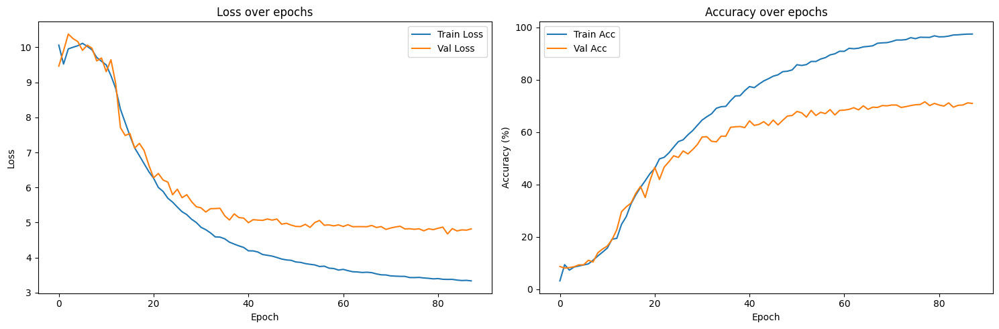

Testing...

Test Accuracy: 72.64%

Classification Report:
              precision    recall  f1-score   support

           0       0.33      0.38      0.35         8
           1       1.00      0.62      0.76        13
           2       0.88      0.79      0.83        19
           3       0.68      0.87      0.76        15
           4       0.92      0.92      0.92        13
           5       0.90      0.82      0.86        11
           6       0.31      0.50      0.38         8
           7       0.60      0.75      0.67        16
           8       0.80      0.67      0.73        12
           9       0.80      0.94      0.86        17
          10       0.94      0.85      0.89        20
          11       0.89      0.89      0.89         9
          12       0.83      0.67      0.74        15
          13       0.90      1.00      0.95         9
          14       0.69      0.64      0.67        14
          15       0.72      0.81      0.76        16
          16       1.00

In [ ]:
import torch
import warnings 
warnings.filterwarnings('ignore')
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report
import os
from torch.cuda.amp import GradScaler, autocast
import matplotlib.pyplot as plt

class ButterflyDataset(Dataset):
    def __init__(self, csv_file, img_dir, transform=None):
        self.data = pd.read_csv(csv_file)
        self.img_dir = img_dir
        self.transform = transform
        self.labels = {label: idx for idx, label in enumerate(self.data['label'].unique())}
        
    def __len__(self):
        return len(self.data)
    
    def __getitem__(self, idx):
        img_name = os.path.join(self.img_dir, self.data.iloc[idx, 0])
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        label = self.labels[self.data.iloc[idx, 1]]
        return image, label

class VectorQuantizer(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, commitment_cost=0.25):
        super().__init__()
        self.embedding_dim = embedding_dim
        self.num_embeddings = num_embeddings
        self.commitment_cost = commitment_cost
        
        self.embeddings = nn.Embedding(num_embeddings, embedding_dim)
        self.embeddings.weight.data.uniform_(-1/num_embeddings, 1/num_embeddings)

    def forward(self, inputs):
        inputs = inputs.permute(0, 2, 3, 1).contiguous()
        input_shape = inputs.shape
        
        flat_input = inputs.view(-1, self.embedding_dim)
        
        distances = (torch.sum(flat_input**2, dim=1, keepdim=True) 
                    + torch.sum(self.embeddings.weight**2, dim=1)
                    - 2 * torch.matmul(flat_input, self.embeddings.weight.t()))
        
        encoding_indices = torch.argmin(distances, dim=1).unsqueeze(1)
        encodings = torch.zeros(encoding_indices.shape[0], self.num_embeddings, device=inputs.device)
        encodings.scatter_(1, encoding_indices, 1)
        
        quantized = torch.matmul(encodings, self.embeddings.weight).view(input_shape)
        
        e_latent_loss = torch.mean((quantized.detach() - inputs)**2)
        q_latent_loss = torch.mean((quantized - inputs.detach())**2)
        loss = q_latent_loss + self.commitment_cost * e_latent_loss
        
        quantized = inputs + (quantized - inputs).detach()
        
        return quantized.permute(0, 3, 1, 2).contiguous(), loss

class SupervisedVQVAE(nn.Module):
    def __init__(self, num_embeddings, embedding_dim, hidden_channels, num_classes):
        super().__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.GELU(),
            
            nn.Conv2d(hidden_channels, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.GELU(),
            
            nn.Conv2d(hidden_channels * 2, embedding_dim, 4, stride=2, padding=1),
            nn.BatchNorm2d(embedding_dim),
            nn.GELU(),
        )
        
        self.vector_quantizer = VectorQuantizer(num_embeddings, embedding_dim)
        
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(embedding_dim, hidden_channels * 2, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels * 2),
            nn.GELU(),
            
            nn.ConvTranspose2d(hidden_channels * 2, hidden_channels, 4, stride=2, padding=1),
            nn.BatchNorm2d(hidden_channels),
            nn.GELU(),
            
            nn.ConvTranspose2d(hidden_channels, 3, 4, stride=2, padding=1),
            nn.Tanh()
        )
        
        # Classification head
        self.classifier = nn.Sequential(
            nn.AdaptiveAvgPool2d((4, 4)),  # Adaptive pooling to fixed size
            nn.Flatten(),
            nn.Linear(embedding_dim * 16, 1024),
            nn.LayerNorm(1024),
            nn.GELU(),
            nn.Dropout(0.5),
            nn.Linear(1024, num_classes)
        )
        
    def forward(self, x):
        z = self.encoder(x)
        z_q, vq_loss = self.vector_quantizer(z)
        x_recon = self.decoder(z_q)
        class_output = self.classifier(z_q)
        return x_recon, vq_loss, class_output

def train_supervised_vqvae(model, train_loader, val_loader, num_epochs, device):

    recon_criterion = nn.MSELoss()
    class_criterion = nn.CrossEntropyLoss(label_smoothing=0.1)
    
    optimizer = optim.AdamW(model.parameters(), lr=1e-3, weight_decay=0.01)
    scheduler = optim.lr_scheduler.OneCycleLR(
        optimizer, 
        max_lr=1e-3,
        epochs=num_epochs,
        steps_per_epoch=len(train_loader),
        pct_start=0.3
    )
    
    scaler = GradScaler()
    best_val_acc = 0
    patience = 10
    patience_counter = 0
    
    history = {
        'train_loss': [], 'train_acc': [],
        'val_loss': [], 'val_acc': []
    }
    
    for epoch in range(num_epochs):
        model.train()
        total_loss = 0
        correct = 0
        total = 0
        

        for batch_idx, (data, labels) in enumerate(train_loader):
            data, labels = data.to(device), labels.to(device)
            optimizer.zero_grad()
            
            with autocast():
                recon, vq_loss, class_output = model(data)
                recon_loss = recon_criterion(recon, data)
                class_loss = class_criterion(class_output, labels)
            
                total_batch_loss = recon_loss + vq_loss + 2.0 * class_loss  # Increased weight for classification
            
            scaler.scale(total_batch_loss).backward()
            scaler.unscale_(optimizer)
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            scaler.step(optimizer)
            scaler.update()
            scheduler.step()
            
            total_loss += total_batch_loss.item()
            
            _, predicted = class_output.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()
            
            if (batch_idx + 1) % 50 == 0:
                print(f'Epoch [{epoch + 1}/{num_epochs}], Batch [{batch_idx + 1}/{len(train_loader)}]')
        
        train_loss = total_loss / len(train_loader)
        train_acc = 100. * correct / total
        
        # Validation loop
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0
        
        with torch.no_grad():
            for data, labels in val_loader:
                data, labels = data.to(device), labels.to(device)
                recon, vq_loss, class_output = model(data)
                
                recon_loss = recon_criterion(recon, data)
                class_loss = class_criterion(class_output, labels)
                batch_loss = recon_loss + vq_loss + 2.0 * class_loss
                
                val_loss += batch_loss.item()
                
                _, predicted = class_output.max(1)
                val_total += labels.size(0)
                val_correct += predicted.eq(labels).sum().item()
        
        val_loss = val_loss / len(val_loader)
        val_acc = 100. * val_correct / val_total
        
        # Update history
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['val_loss'].append(val_loss)
        history['val_acc'].append(val_acc)
        
        print(f'Epoch [{epoch + 1}/{num_epochs}]: Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%, '
              f'Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%')
        
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            torch.save(model.state_dict(), 'best_supervised_vqvae.pth')
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print(f"Early stopping triggered after {epoch + 1} epochs")
                break
    
    return history

def plot_training_history(history):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))
    
   
    ax1.plot(history['train_loss'], label='Train Loss')
    ax1.plot(history['val_loss'], label='Val Loss')
    ax1.set_title('Loss over epochs')
    ax1.set_xlabel('Epoch')
    ax1.set_ylabel('Loss')
    ax1.legend()
    
    
    ax2.plot(history['train_acc'], label='Train Acc')
    ax2.plot(history['val_acc'], label='Val Acc')
    ax2.set_title('Accuracy over epochs')
    ax2.set_xlabel('Epoch')
    ax2.set_ylabel('Accuracy (%)')
    ax2.legend()
    
    plt.tight_layout()
    plt.show()

def main():
    # Hyperparameters
    embedding_dim = 256 
    num_embeddings = 1024 
    hidden_channels = 128
    num_epochs = 100
    batch_size = 32
    num_classes = 75  
    
    # Device configuration
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    print(f"Using device: {device}")
    
    # Data transformation
    transform = transforms.Compose([
        transforms.Resize((128, 128)),
        transforms.RandomHorizontalFlip(),
        transforms.RandomRotation(10),
        transforms.ColorJitter(brightness=0.2, contrast=0.2),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    
    # Dataset and loaders
    dataset = ButterflyDataset(
        csv_file='/home/smehul/Desktop/archive/Training_set.csv', 
        img_dir='/home/smehul/Desktop/archive/train',  
        transform=transform
    )
    
    # Split dataset
    train_size = int(0.7 * len(dataset))
    val_size = int(0.15 * len(dataset))
    test_size = len(dataset) - train_size - val_size
    train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(
        dataset, [train_size, val_size, test_size]
    )
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, num_workers=4)
    
    # Initialize model
    model = SupervisedVQVAE(
        num_embeddings=num_embeddings,
        embedding_dim=embedding_dim,
        hidden_channels=hidden_channels,
        num_classes=num_classes
    ).to(device)
    
    # Train model
    history = train_supervised_vqvae(model, train_loader, val_loader, num_epochs, device)
    
    # Plot training history
    plot_training_history(history)
    
    # Evaluate on test set
    model.load_state_dict(torch.load('best_supervised_vqvae.pth'))
    model.eval()
    test_correct = 0
    test_total = 0
    all_preds = []
    all_labels = []
    
    print("Testing...")
    with torch.no_grad():
        for data, labels in test_loader:
            data, labels = data.to(device), labels.to(device)
            _, _, class_output = model(data)
            _, predicted = class_output.max(1)
            test_total += labels.size(0)
            test_correct += predicted.eq(labels).sum().item()
            
            all_preds.extend(predicted.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    test_acc = 100. * test_correct / test_total
    print(f"\nTest Accuracy: {test_acc:.2f}%")
    print("\nClassification Report:")
    print(classification_report(all_labels, all_preds))

if __name__ == "__main__":
    main()

#### The reasons why this is better could be:
#### In end-to-end training, the VQVAE learns representations that are specifically useful for classification.
#### When training separately, the VQVAE focuses solely on reconstruction quality
#### Some class-relevant information might be lost during quantization
#### Joint training ensures important discriminative features are preserved in the latent space




#### Key advantages of 2D latent vectors in VQ-VAE:
#### Spatial Information Preservation.


#### 2D latent spaces preserve spatial relationships from the input image.
#### OpenAI's DALL-E paper uses VQ-VAE with 2D latent spaces:
#### Uses a 32x32 latent space for 256x256 images

# Question 8 : Fitting a GMM on the latent space of VQ-VAE

Loading model and latents...
Latent shape: (4549, 16, 16)
Latent range: [0, 510]
Latent mean: 261.6568957463179
Latent std: 156.01895818733226
Fitting GMM...
Generating samples...
Plotting results...


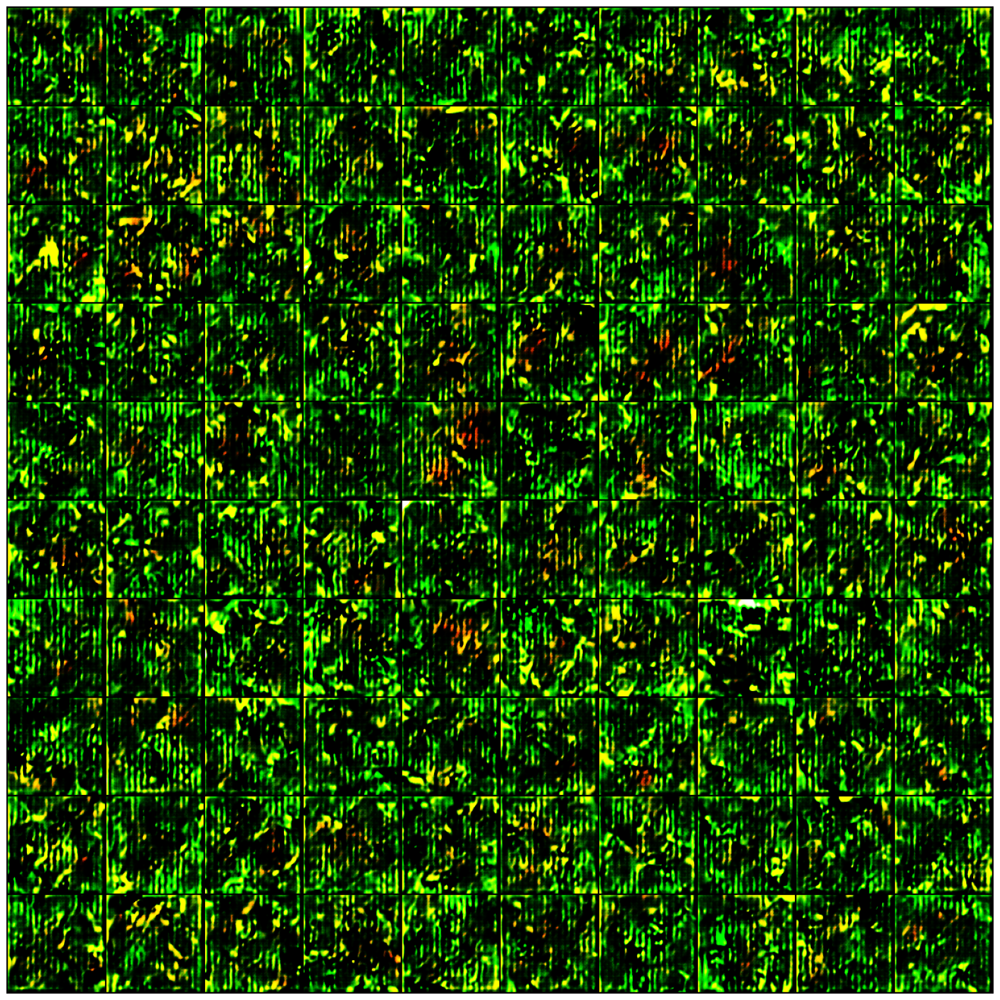

In [ ]:
import torch
import numpy as np
from sklearn.mixture import GaussianMixture
import matplotlib.pyplot as plt
from torchvision.utils import make_grid

def load_model_and_latents():
    # Load the full VQ-VAE model
    model = ImprovedVQVAE(
        num_embeddings=512,
        embedding_dim=128,
        hidden_channels=128,
        num_residual_layers=6
    )
    
    # Load the saved state dict
    model.load_state_dict(torch.load('best_vqvae.pth'))
    model.eval()
    
    # Load the latent vectors
    latent_data = np.load('latent_vectors.npz')
    train_latents = latent_data['train_latents']
    
    return model, train_latents

def fit_gmm(latents, n_components=50):  # Increased number of components
    # Reshape latents to 2D array for GMM
    flat_latents = latents.reshape(latents.shape[0], -1)
    
    # Normalize the latents
    latents_mean = np.mean(flat_latents, axis=0)
    latents_std = np.std(flat_latents, axis=0) + 1e-6
    flat_latents = (flat_latents - latents_mean) / latents_std
    
    # Fit GMM with more components and better initialization
    gmm = GaussianMixture(
        n_components=n_components,
        covariance_type='full',
        max_iter=500,
        n_init=10,
        random_state=42
    )
    gmm.fit(flat_latents)
    
    return gmm, latents_mean, latents_std

def generate_samples(gmm, model, latents_mean, latents_std, num_samples=100, device='cuda'):
    # Sample from GMM
    samples, _ = gmm.sample(num_samples*128)
    
    # Denormalize samples
    samples = samples * latents_std + latents_mean
    
    # Reshape samples back to [num_samples, embedding_dim, 16, 16]
    samples = samples.reshape(num_samples, model.vector_quantizer.embedding_dim, 16, 16)
    
    # Convert to torch tensor and move to device
    samples = torch.FloatTensor(samples).to(device)
    
    # Generate reconstructions
    with torch.no_grad():
        # Get quantized vectors directly
        z_q, _, _ = model.vector_quantizer(samples)
        
        # Decode
        reconstructions = model.decoder(z_q)
        
        # Ensure output is in proper range
        reconstructions = torch.tanh(reconstructions)
    
    return reconstructions

def plot_samples(samples, nrow=10, save_path=None):
    # Create a grid of images
    grid = make_grid(samples, nrow=nrow, normalize=True)
    
    # Convert to numpy and transpose for plotting
    grid = grid.cpu().numpy().transpose(1, 2, 0)
    
    # Plot with better visualization
    plt.figure(figsize=(20, 20))
    plt.imshow(grid)
    plt.axis('off')
    
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
    plt.show()

def validate_latents(train_latents):
    """Validate the latent vectors for potential issues"""
    print(f"Latent shape: {train_latents.shape}")
    print(f"Latent range: [{train_latents.min()}, {train_latents.max()}]")
    print(f"Latent mean: {train_latents.mean()}")
    print(f"Latent std: {train_latents.std()}")
    
    # Check for NaN or inf values
    if np.any(np.isnan(train_latents)) or np.any(np.isinf(train_latents)):
        print("WARNING: Found NaN or inf values in latents!")


device = 'cpu'

# Load model and latents
print("Loading model and latents...")
model, train_latents = load_model_and_latents()
model = model.to(device)

# Validate latents
validate_latents(train_latents)

# Fit GMM on latent vectors
print("Fitting GMM...")
gmm, latents_mean, latents_std = fit_gmm(train_latents)

# Generate and plot samples
print("Generating samples...")
samples = generate_samples(gmm, model, latents_mean, latents_std, num_samples=100, device=device)

# Plot results
print("Plotting results...")
plot_samples(samples, save_path='generated_samples.png')

Analysis of VQ-VAE + GMM Reconstruction Issues

Observed Problems

Reconstructed images exhibit:

	1.	Blurry patterns with vertical striping artifacts
	2.	Green-yellow dominance over natural butterfly colors
	3.	Lack of fine details, textures, and clear butterfly structures

Analysis of Approaches

Approach 1: GMM on Discrete Indices

Issue: GMM’s continuous nature clashed with VQ-VAE’s discrete indices, losing spatial and contextual integrity.

Approach 2: GMM on Continuous Latents with Direct Decoding

Issue: Bypassing quantization misaligned generated latents with the codebook, causing blur and feature loss.

Approach 3: GMM with Proper Quantization

Issue: While slightly improved, structure remained subpar, suggesting underlying architectural or training deficiencies.

Possible Causes

	1.	VQ-VAE Architecture: Limited encoder/decoder capacity, small codebook size, and insufficient hierarchical representation.
	2.	Training Problems: Possible underfitting, unbalanced commitment loss, optimization issues, or insufficient data.
	3.	Latent Space Constraints: Small 16x16 latent spatial dimension and loss of spatial coherence.
	4.	GMM Limitations: Single Gaussian components fail to capture complex structures; independent sampling loses correlations.

Conclusion

The reconstruction issues likely arise from architectural limitations, training inefficiencies, and an inadequate GMM prior. For immediate improvement:

	1.	Expand model capacity
	2.	Implement hierarchical structure
	3.	Use autoregressive prior instead of GMM
	4.	Add perceptual losses
	5.	Apply conditional generation if labels are available

These changes should enhance detail, coherence, and structure in butterfly reconstructions.